In [1]:
%config Completer.use_jedi = False

In [2]:
import time

import cv2
import numpy as np
import tensorflow as tf
tf.compat.v1.disable_eager_execution()

from tf_pose.estimator import TfPoseEstimator
from tf_pose.networks import get_graph_path, model_wh

import matplotlib.pyplot as plt

In [3]:
w, h = model_wh("432x368")

In [4]:
w, h

(432, 368)

In [5]:
model_path = 'mobilenet_thin'

# e = TfPoseEstimator(get_graph_path(args.model), target_size=(w, h))
e = TfPoseEstimator(get_graph_path(model_path), target_size=(w, h))

[2021-08-06 11:43:53,360] [TfPoseEstimator] [INFO] loading graph from /home/local/ALGOANALYTICS/arun/arun_work/CAFIS_Nikhil/tf-pose-estimation/tf2-pose/models/graph/mobilenet_thin/graph_opt.pb(default size=432x368)
2021-08-06 11:43:53,360 INFO loading graph from /home/local/ALGOANALYTICS/arun/arun_work/CAFIS_Nikhil/tf-pose-estimation/tf2-pose/models/graph/mobilenet_thin/graph_opt.pb(default size=432x368)


TfPoseEstimator/MobilenetV1/Conv2d_0/weights
TfPoseEstimator/image
TfPoseEstimator/MobilenetV1/Conv2d_0/Conv2D
TfPoseEstimator/MobilenetV1/Conv2d_0/Conv2D_bn_offset
TfPoseEstimator/MobilenetV1/Conv2d_0/BatchNorm/FusedBatchNorm
TfPoseEstimator/MobilenetV1/Conv2d_0/Relu
TfPoseEstimator/MobilenetV1/Conv2d_1_depthwise/depthwise_weights
TfPoseEstimator/MobilenetV1/Conv2d_1_pointwise/weights
TfPoseEstimator/MobilenetV1/Conv2d_1_depthwise/depthwise
TfPoseEstimator/MobilenetV1/Conv2d_1_pointwise/Conv2D
TfPoseEstimator/MobilenetV1/Conv2d_1_pointwise/Conv2D_bn_offset
TfPoseEstimator/MobilenetV1/Conv2d_1_pointwise/BatchNorm/FusedBatchNorm
TfPoseEstimator/MobilenetV1/Conv2d_1_pointwise/Relu
TfPoseEstimator/MobilenetV1/Conv2d_2_depthwise/depthwise_weights
TfPoseEstimator/MobilenetV1/Conv2d_2_pointwise/weights
TfPoseEstimator/MobilenetV1/Conv2d_2_depthwise/depthwise
TfPoseEstimator/MobilenetV1/Conv2d_2_pointwise/Conv2D
TfPoseEstimator/MobilenetV1/Conv2d_2_pointwise/Conv2D_bn_offset
TfPoseEstimator/M

2021-08-06 11:43:54,841 WARNING From /home/local/ALGOANALYTICS/arun/arun_work/CAFIS_Nikhil/human_detection/human-detection/lib/python3.6/site-packages/tensorflow/python/ops/resource_variable_ops.py:1666: calling BaseResourceVariable.__init__ (from tensorflow.python.ops.resource_variable_ops) with constraint is deprecated and will be removed in a future version.
Instructions for updating:
If using Keras pass *_constraint arguments to layers.


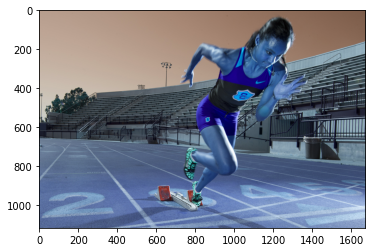

In [7]:
image_path  = 'test_pose.jfif'
image = cv2.imread(image_path)
plt.imshow(image)
plt.show()

In [8]:
humans = e.inference(
        image, resize_to_default=True, upsample_size=4.0
    )

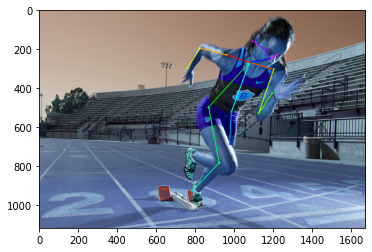

In [9]:
image = TfPoseEstimator.draw_humans(image, humans, imgcopy=False)
plt.imshow(image)
plt.show()

In [37]:
from tf_pose import common
from tf_pose.common import CocoPart, CocoPairsRender

image_h, image_w = image.shape[:2]

joints, bboxes, xcenter, ycenter = [], [], [], []
# for record and get dataset
record_joints_norm = []
skeletal_coordinates = []
bodys_sequence = []
bodys_probability = []
bodys_direction = []
body_parts = []
draw_ellipse_requirements = []
ellipse_pool = []
ellipse_boxes = []
im_size = (image_w,image_h)

for human_index,human in enumerate(humans):
    xs, ys, centers = [], [], {}
    body_sequence = []
    body_probability = 0.0
    # draw nodes
    for i in range(CocoPart.Background.value):
        if i not in human.body_parts.keys():
            # for missing joints add 0
            record_joints_norm += [0.0, 0.0]
            continue

        body_part = human.body_parts[i]
        center_x = body_part.x * image_w + 0.5
        center_y = body_part.y * image_h + 0.5
        center = (int(center_x), int(center_y))
        centers[i] = center

        record_joints_norm += [round(center_x/640, 2), round(center_y/480, 2)]
        xs.append(center[0])
        ys.append(center[1])

        # for social distancing
        body_sequence.append(center_x)
        body_sequence.append(center_y)

        # Sum joints probability to find body probability
        body_probability += body_part.score

#         # draw joints
#         cv.circle(npimg, center, 3, CocoColors[i], thickness=TfPoseVisualizer.Thickness_ratio * 2,
#                   lineType=8, shift=0)
    # connect joints for same person
    for pair_order, pair in enumerate(CocoPairsRender):
        if pair[0] not in human.body_parts.keys() or pair[1] not in human.body_parts.keys():
            continue
#         cv.line(npimg, centers[pair[0]], centers[pair[1]], CocoColors[pair_order],
#                 thickness=TfPoseVisualizer.Thickness_ratio, lineType=8, shift=0)


    # generate roi area according to joint points
    tl_x = min(xs)
    tl_y = min(ys)
    width = max(xs) - min(xs)
    height = max(ys) - min(ys)
    bboxes.append([tl_x, tl_y, width, height])

    # record all nodes in single matrix
    joints.append(centers)

    # for social distancing
    body_probability = body_probability/len(human.body_parts)

    # Add body sequence to list
    bodys_sequence.append(body_sequence)
    bodys_probability.append(body_probability)
    #bodys_direction.append(direction)
    body_parts.append(human.body_parts)


    # consider first point as xcenter
    if 1 in centers:
        xcenter.append(centers[1][0])
        ycenter.append(centers[1][1])

    skeletal_coordinates = [bodys_sequence, bodys_probability, body_parts]

## With resizing (to default) 

In [10]:
model_path = 'mobilenet_thin'

# e = TfPoseEstimator(get_graph_path(args.model), target_size=(w, h))
e = TfPoseEstimator(get_graph_path(model_path), target_size=(w, h))

[2021-08-06 11:57:12,374] [TfPoseEstimator] [INFO] loading graph from /home/local/ALGOANALYTICS/arun/arun_work/CAFIS_Nikhil/tf-pose-estimation/tf2-pose/models/graph/mobilenet_thin/graph_opt.pb(default size=432x368)
2021-08-06 11:57:12,374 INFO loading graph from /home/local/ALGOANALYTICS/arun/arun_work/CAFIS_Nikhil/tf-pose-estimation/tf2-pose/models/graph/mobilenet_thin/graph_opt.pb(default size=432x368)


TfPoseEstimator/image
TfPoseEstimator/MobilenetV2/Conv/BatchNorm/Const
TfPoseEstimator/MobilenetV2/Conv/BatchNorm/Const_1
TfPoseEstimator/MobilenetV2/expanded_conv/depthwise/BatchNorm/Const
TfPoseEstimator/MobilenetV2/expanded_conv/depthwise/BatchNorm/Const_1
TfPoseEstimator/MobilenetV2/expanded_conv/project/BatchNorm/Const
TfPoseEstimator/MobilenetV2/expanded_conv/project/BatchNorm/Const_1
TfPoseEstimator/MobilenetV2/expanded_conv_1/expand/BatchNorm/Const
TfPoseEstimator/MobilenetV2/expanded_conv_1/expand/BatchNorm/Const_1
TfPoseEstimator/MobilenetV2/expanded_conv_1/depthwise/BatchNorm/Const
TfPoseEstimator/MobilenetV2/expanded_conv_1/depthwise/BatchNorm/Const_1
TfPoseEstimator/MobilenetV2/expanded_conv_1/project/BatchNorm/Const
TfPoseEstimator/MobilenetV2/expanded_conv_1/project/BatchNorm/Const_1
TfPoseEstimator/MobilenetV2/expanded_conv_2/expand/BatchNorm/Const
TfPoseEstimator/MobilenetV2/expanded_conv_2/expand/BatchNorm/Const_1
TfPoseEstimator/MobilenetV2/expanded_conv_2/depthwise/

(504, 896, 3)
total time take 0.9111571311950684


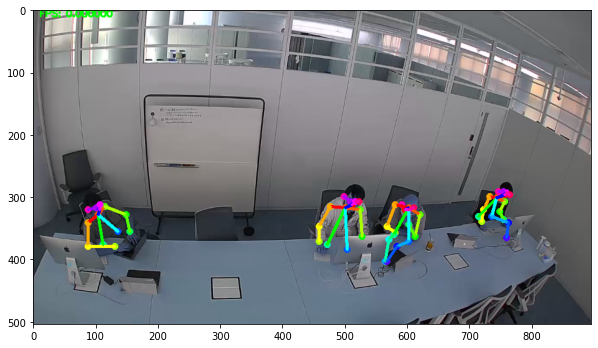

(504, 896, 3)
total time take 0.8853302001953125


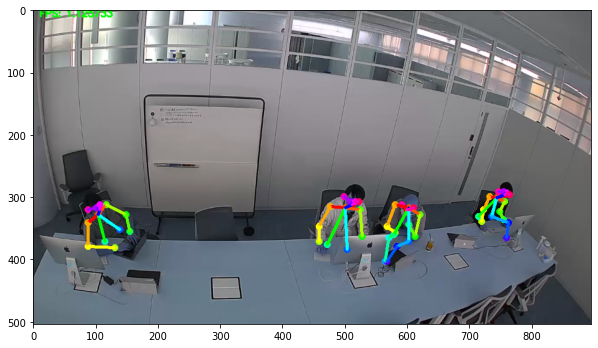

(504, 896, 3)
total time take 0.9069085121154785


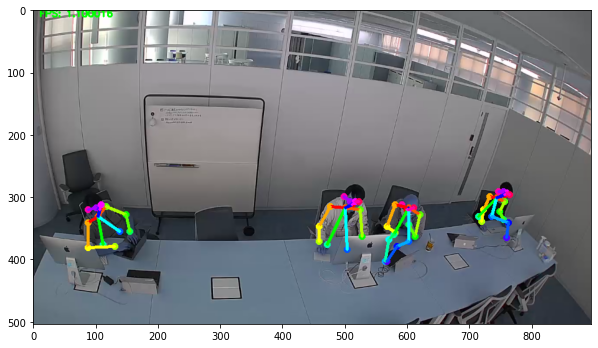

(504, 896, 3)
total time take 0.9057250022888184


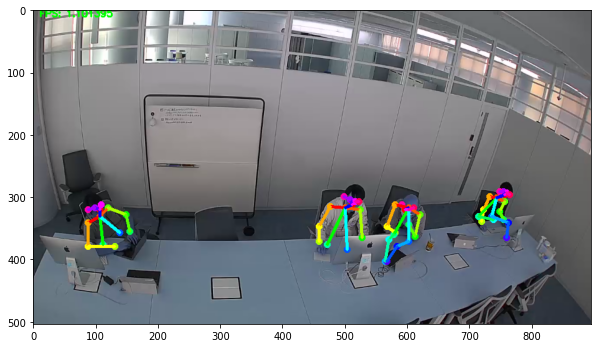

(504, 896, 3)
total time take 0.9232268333435059


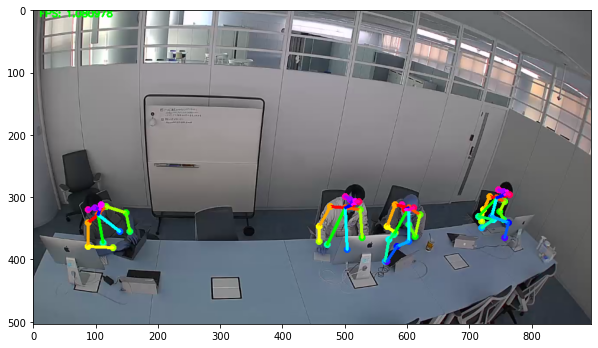

(504, 896, 3)
total time take 0.9090721607208252


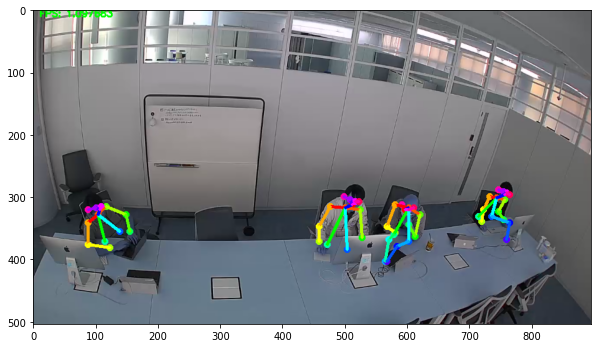

(504, 896, 3)
total time take 0.9218437671661377


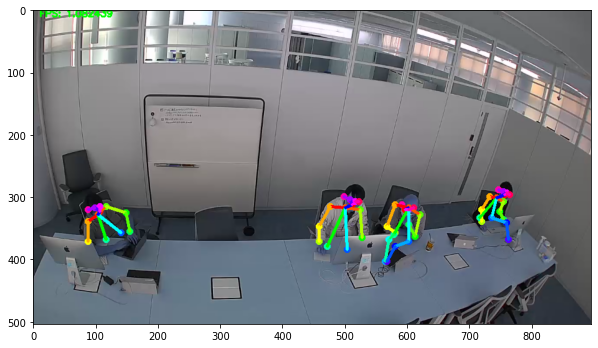

(504, 896, 3)
total time take 0.9083209037780762


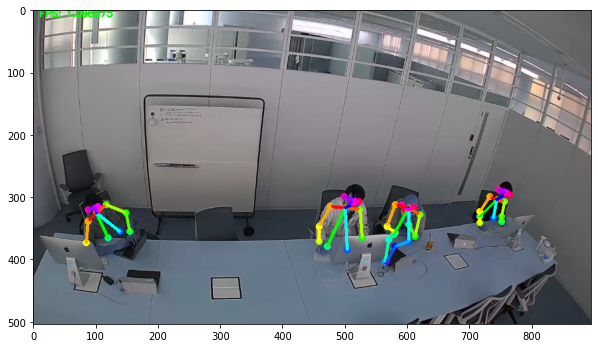

(504, 896, 3)
total time take 0.8949248790740967


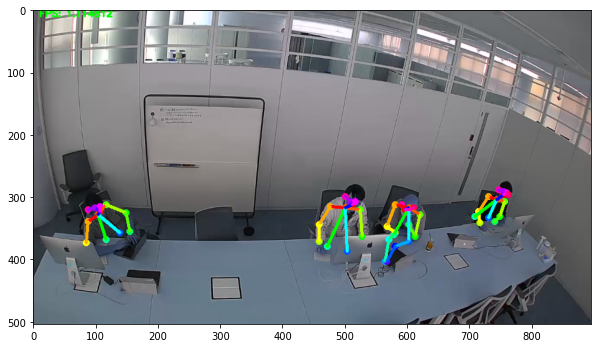

(504, 896, 3)
total time take 0.8953099250793457


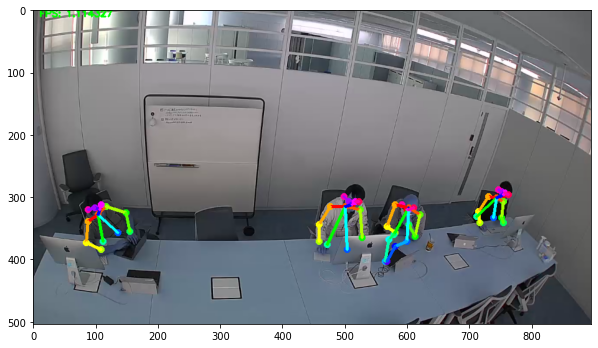

(504, 896, 3)
total time take 0.9223794937133789


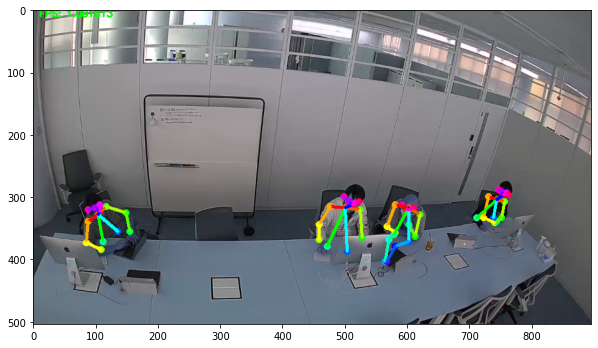

(504, 896, 3)
total time take 0.9182579517364502


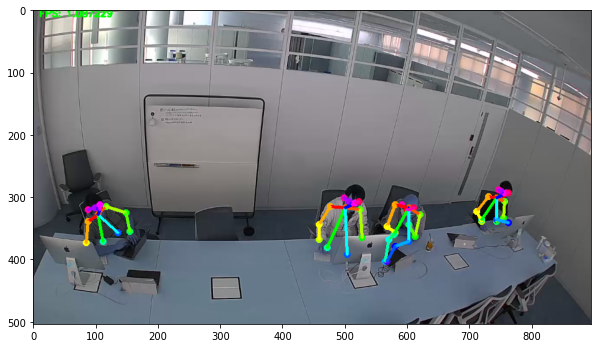

(504, 896, 3)
total time take 0.9265134334564209


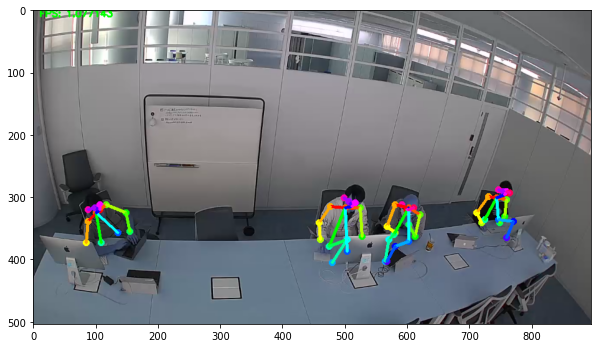

(504, 896, 3)
total time take 0.9161491394042969


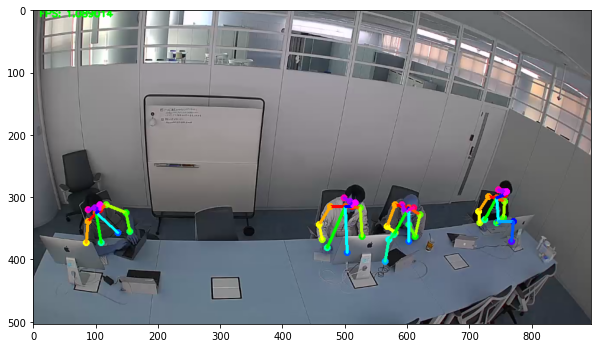

(504, 896, 3)
total time take 0.9101243019104004


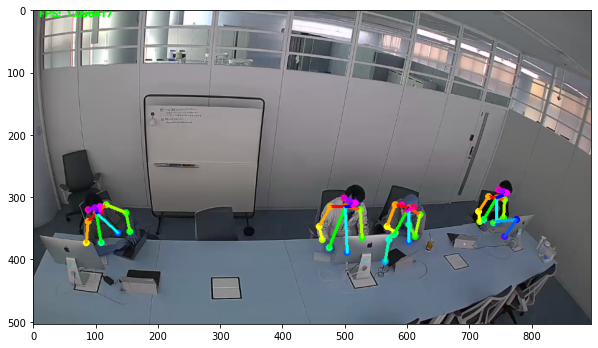

(504, 896, 3)
total time take 0.9234280586242676


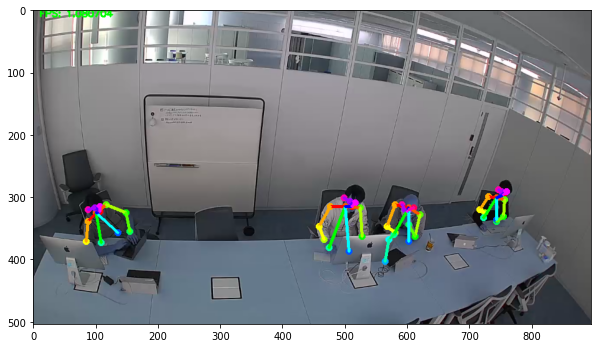

(504, 896, 3)
total time take 0.9091928005218506


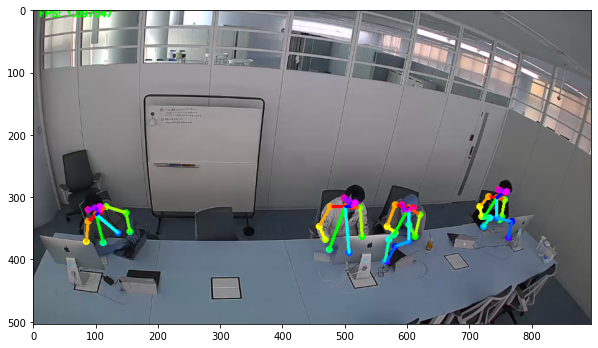

(504, 896, 3)
total time take 0.9079635143280029


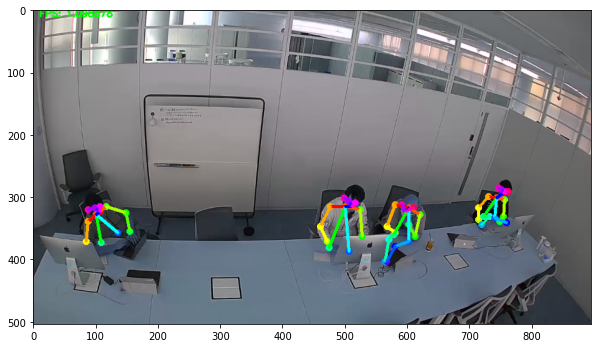

(504, 896, 3)
total time take 0.9035758972167969


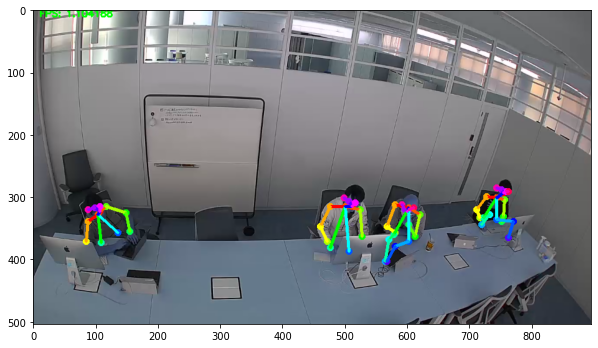

(504, 896, 3)
total time take 0.8991231918334961


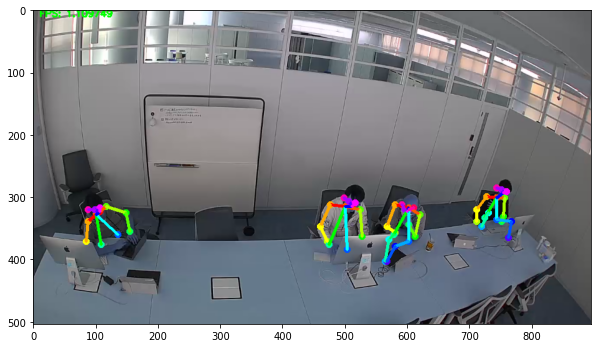

(504, 896, 3)
total time take 0.9078729152679443


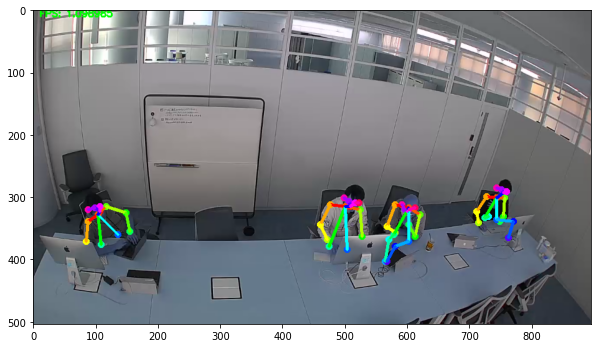

(504, 896, 3)
total time take 0.902318000793457


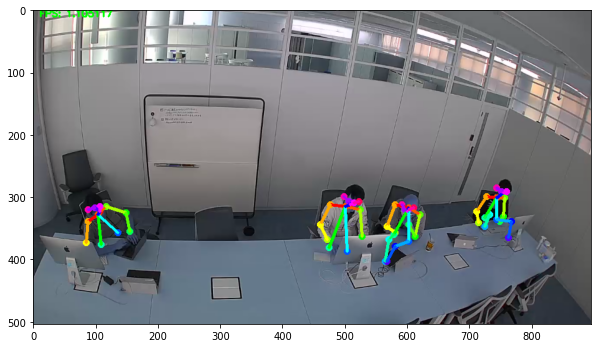

(504, 896, 3)
total time take 0.907883882522583


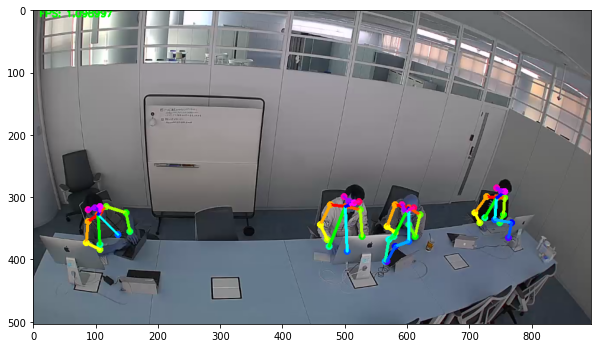

(504, 896, 3)
total time take 0.9265234470367432


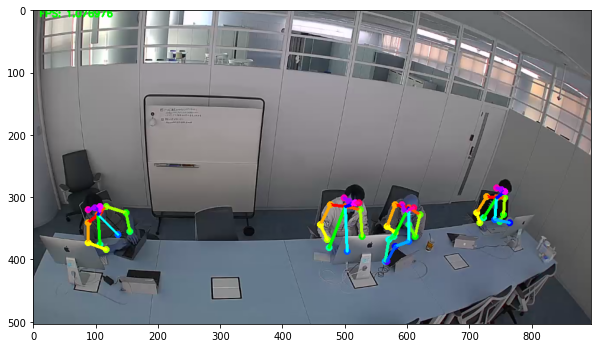

(504, 896, 3)
total time take 0.9058775901794434


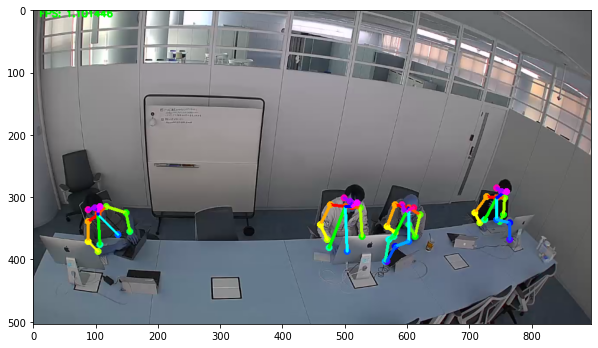

(504, 896, 3)
total time take 0.9315018653869629


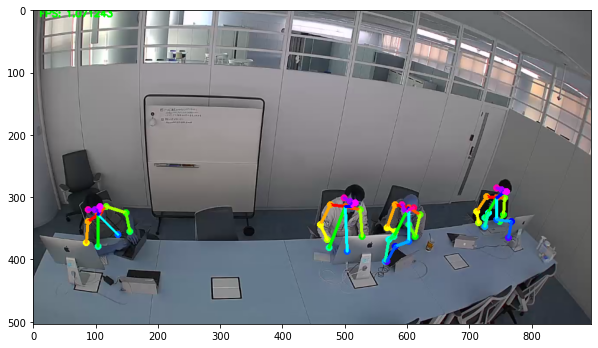

(504, 896, 3)
total time take 0.9103612899780273


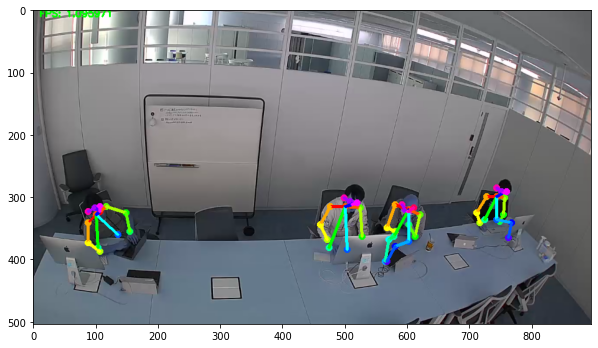

(504, 896, 3)
total time take 0.9134714603424072


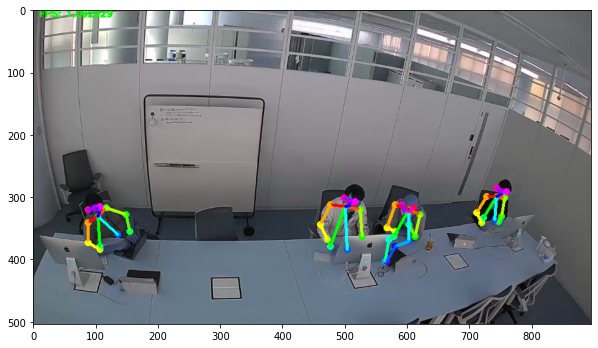

(504, 896, 3)
total time take 0.9252049922943115


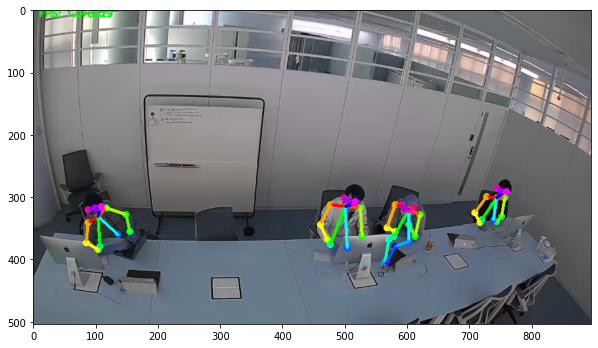

(504, 896, 3)
total time take 0.919316291809082


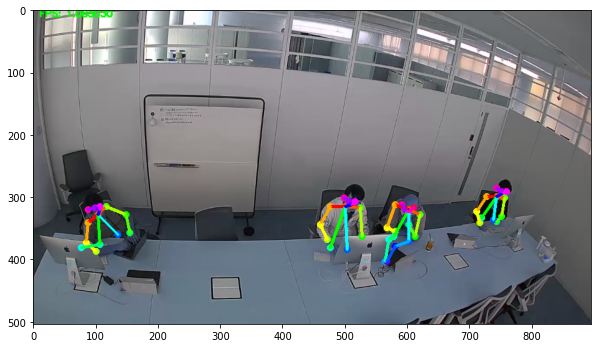

(504, 896, 3)
total time take 0.8903279304504395


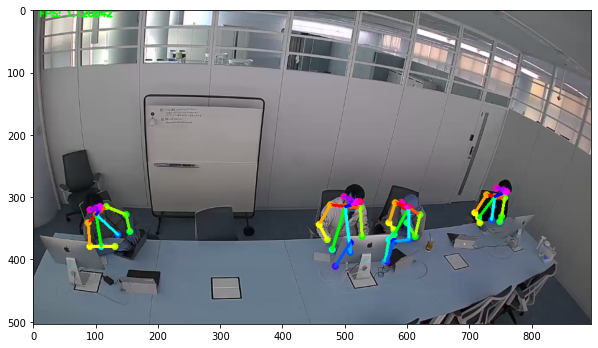

(504, 896, 3)
total time take 0.9240591526031494


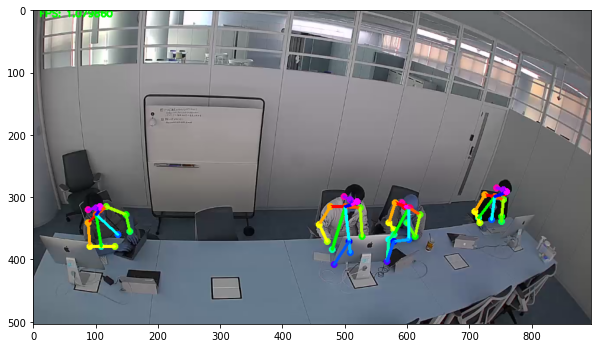

(504, 896, 3)
total time take 0.9207987785339355


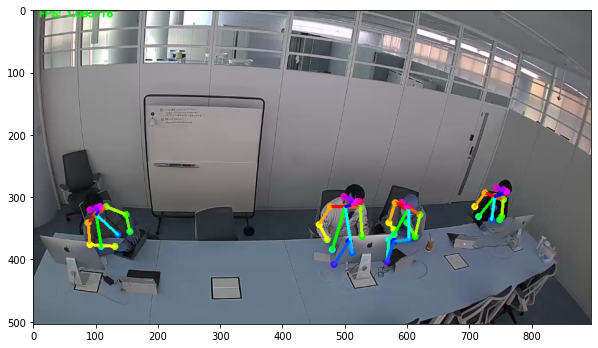

(504, 896, 3)
total time take 0.92781662940979


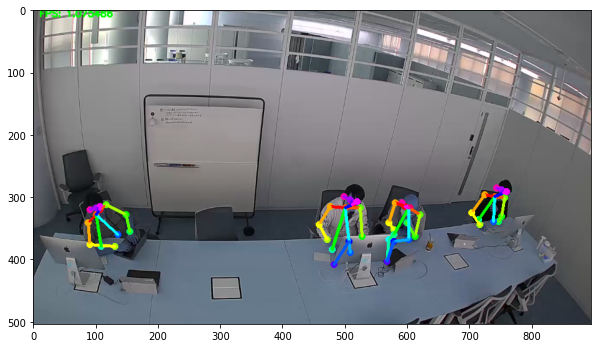

(504, 896, 3)
total time take 0.9264371395111084


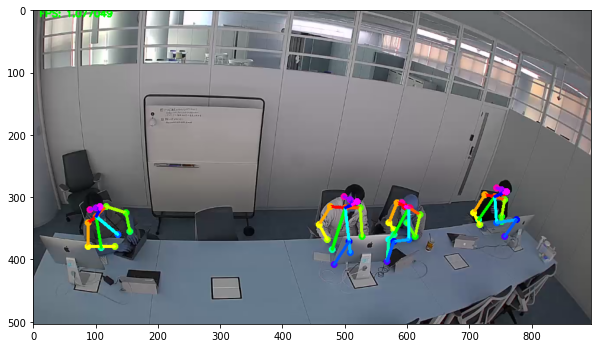

(504, 896, 3)
total time take 0.9131624698638916


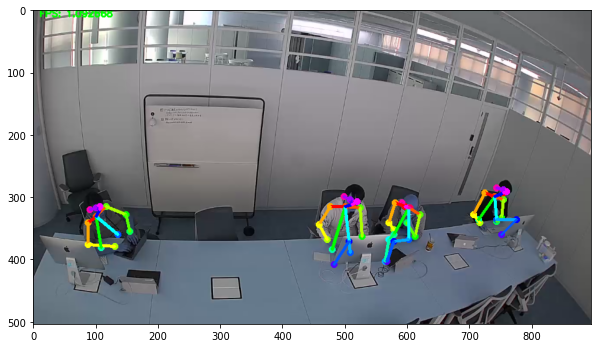

(504, 896, 3)
total time take 0.905125617980957


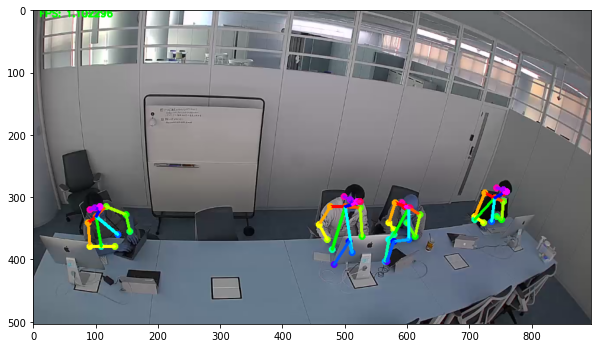

(504, 896, 3)
total time take 0.9187438488006592


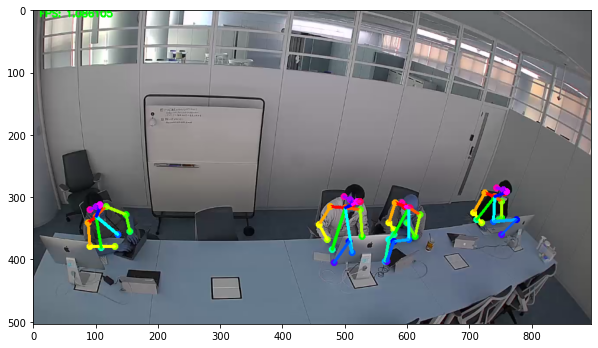

(504, 896, 3)
total time take 0.9093613624572754


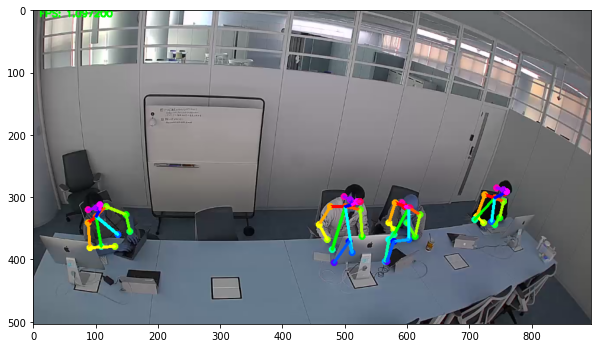

(504, 896, 3)
total time take 0.8858234882354736


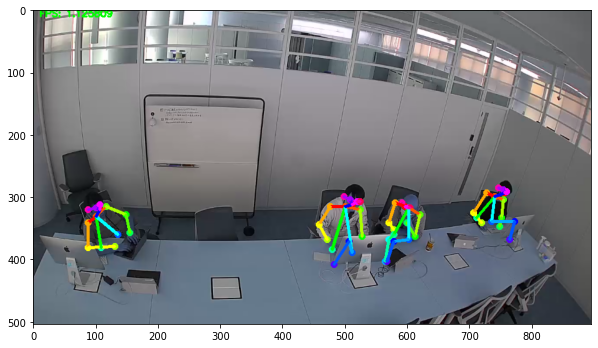

(504, 896, 3)
total time take 0.9025752544403076


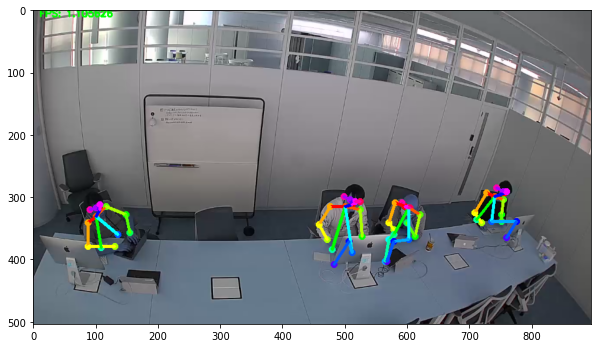

(504, 896, 3)
total time take 0.9278478622436523


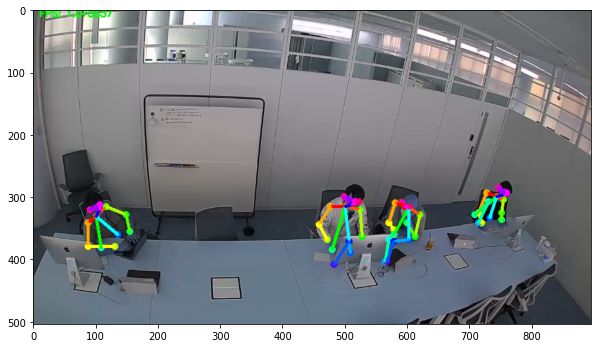

(504, 896, 3)
total time take 0.9187250137329102


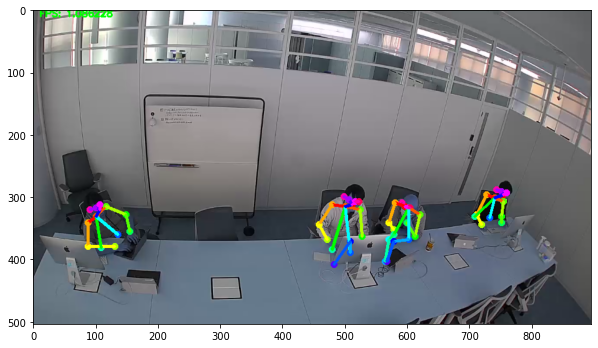

(504, 896, 3)
total time take 0.917902946472168


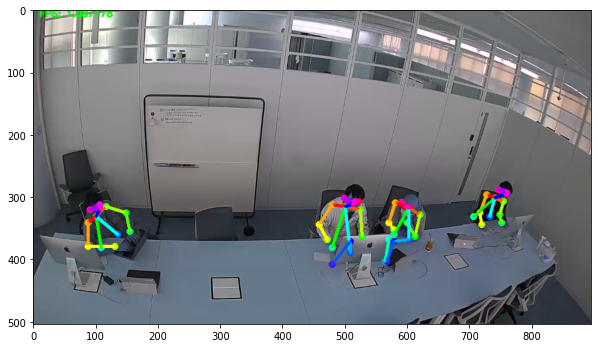

(504, 896, 3)
total time take 0.932478666305542


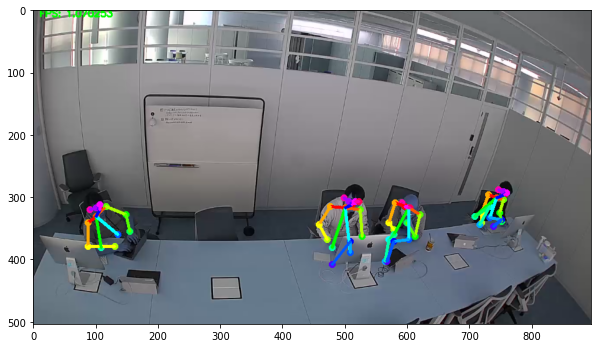

(504, 896, 3)
total time take 0.9273946285247803


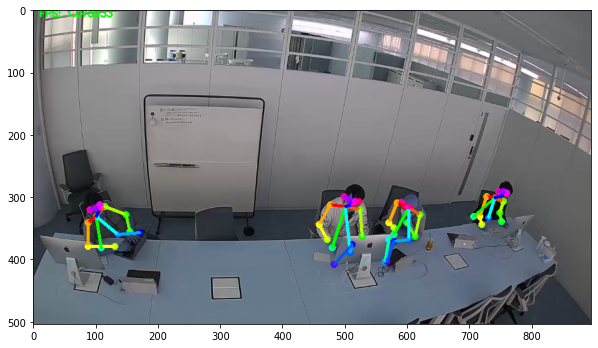

(504, 896, 3)
total time take 0.901602029800415


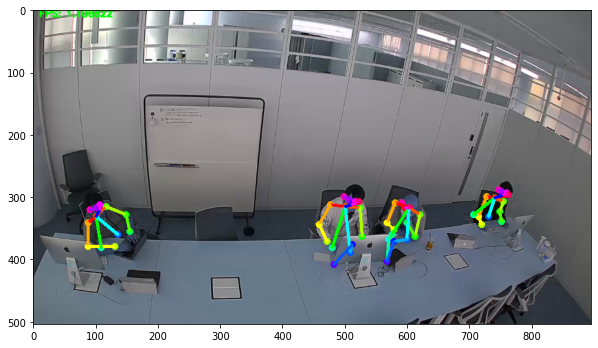

(504, 896, 3)
total time take 0.8994200229644775


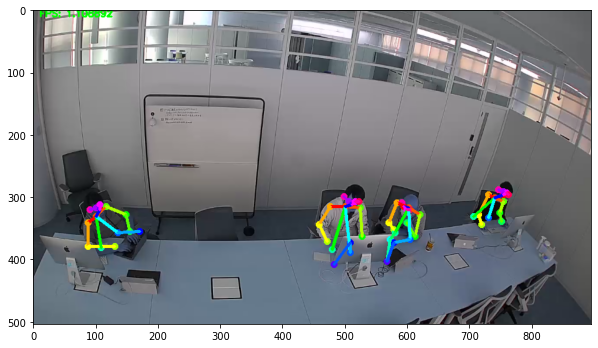

(504, 896, 3)
total time take 0.9121103286743164


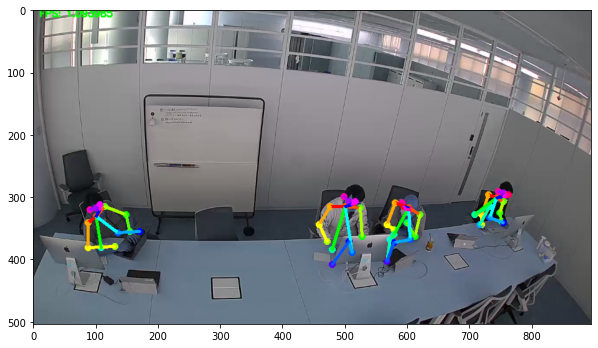

(504, 896, 3)
total time take 0.9288911819458008


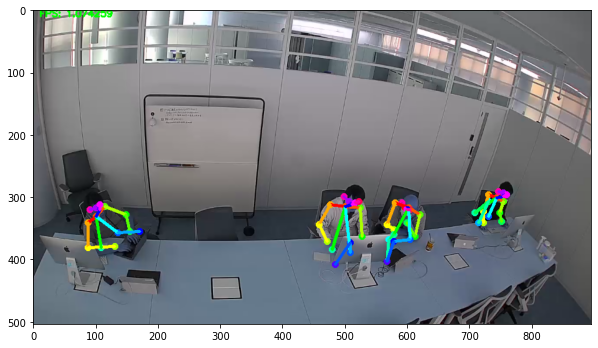

(504, 896, 3)
total time take 0.9118952751159668


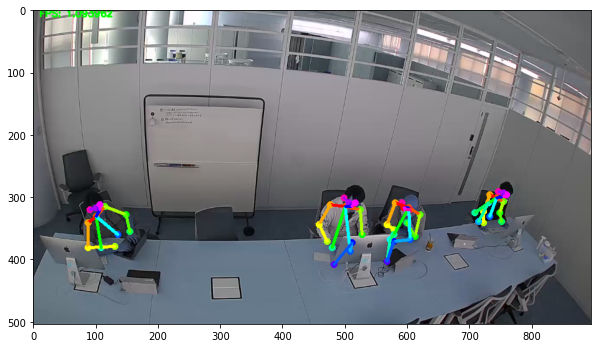

(504, 896, 3)
total time take 0.9232995510101318


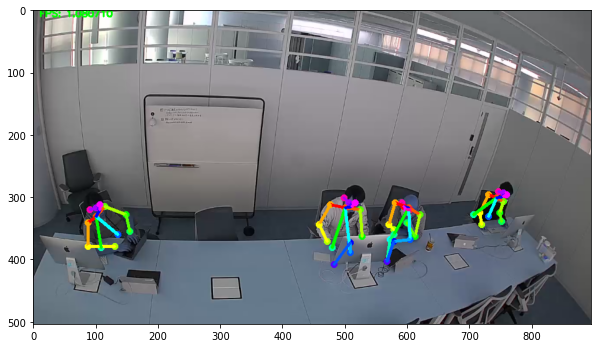

(504, 896, 3)
total time take 0.9142961502075195


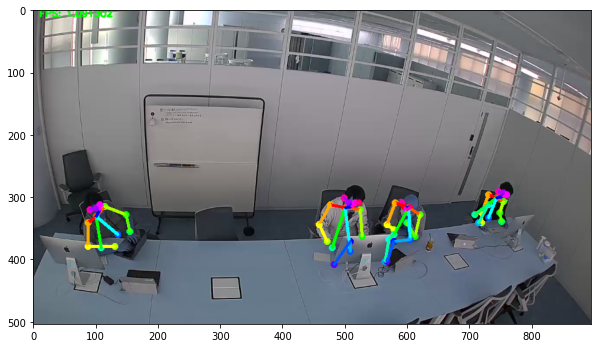

(504, 896, 3)
total time take 0.9417431354522705


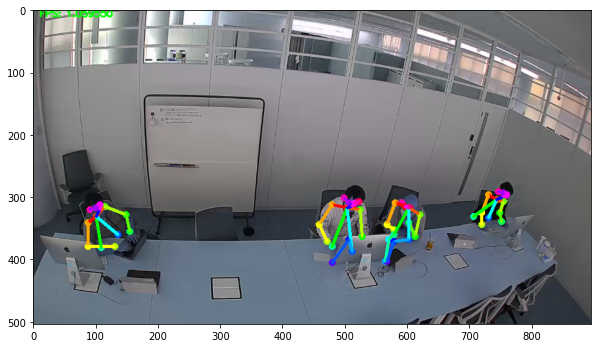

(504, 896, 3)
total time take 0.9085056781768799


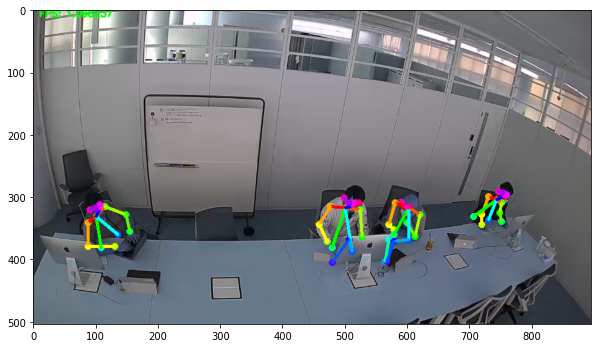

(504, 896, 3)
total time take 0.9114341735839844


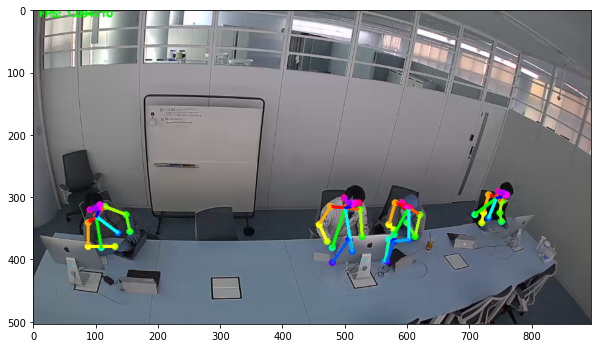

(504, 896, 3)
total time take 0.9043054580688477


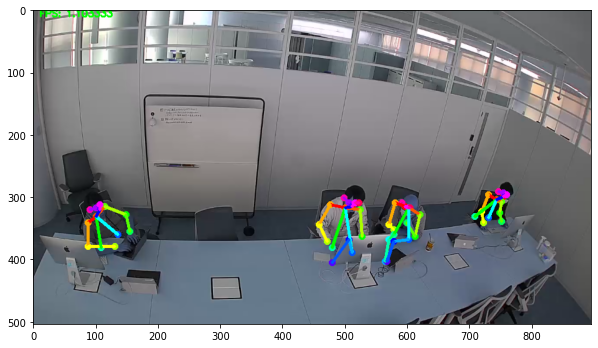

(504, 896, 3)
total time take 0.8969893455505371


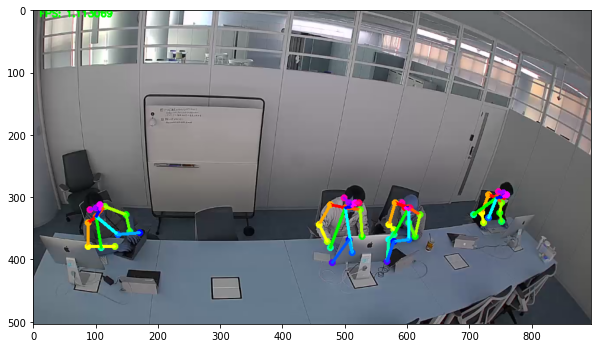

(504, 896, 3)
total time take 0.909421443939209


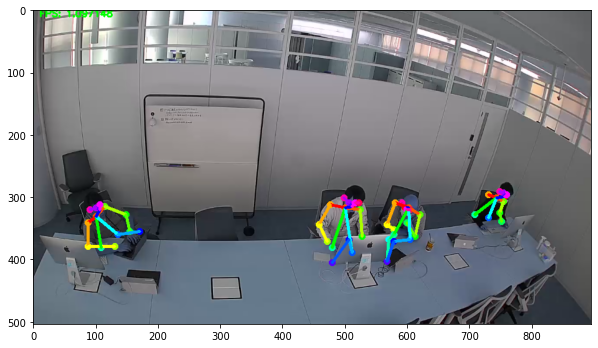

(504, 896, 3)
total time take 0.933523416519165


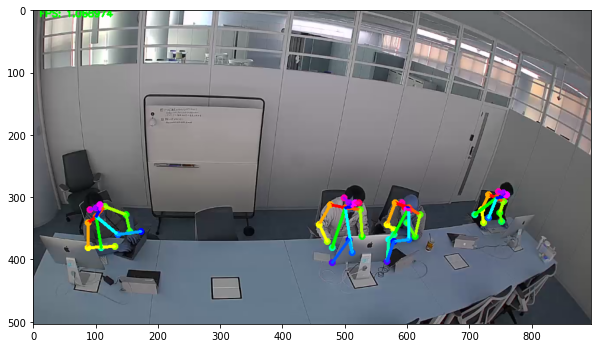

(504, 896, 3)
total time take 0.9306192398071289


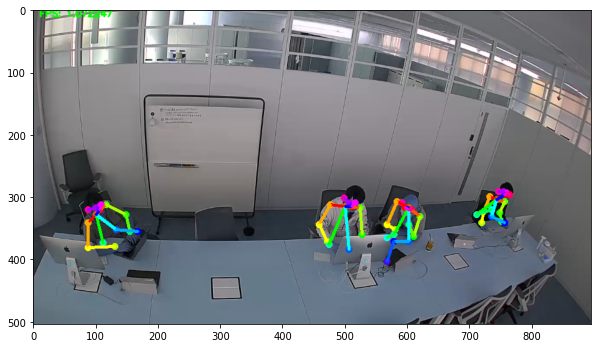

(504, 896, 3)
total time take 0.9182069301605225


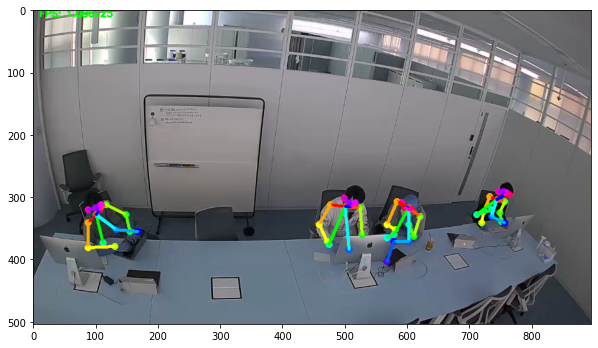

(504, 896, 3)
total time take 0.9207837581634521


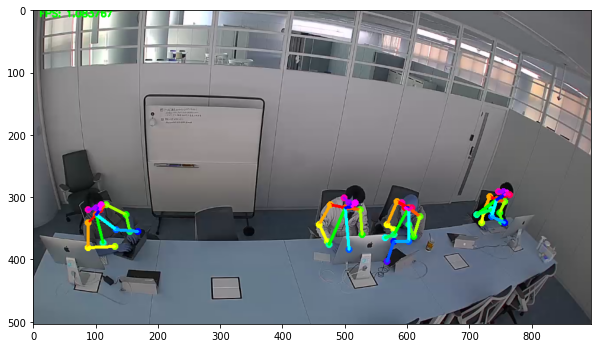

(504, 896, 3)
total time take 0.8876471519470215


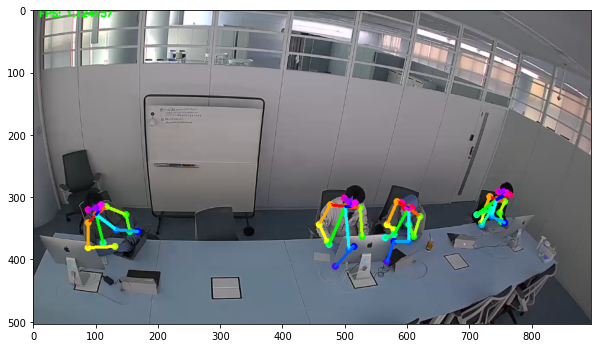

(504, 896, 3)
total time take 0.8967201709747314


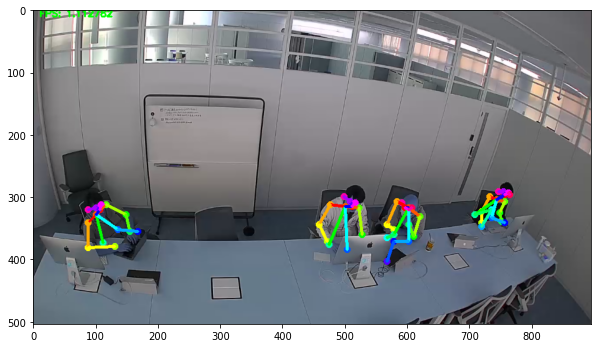

(504, 896, 3)
total time take 0.8983573913574219


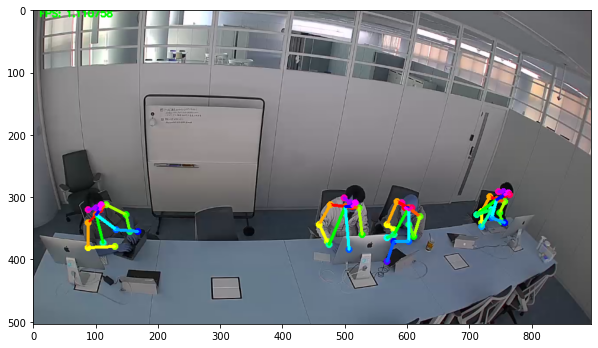

(504, 896, 3)
total time take 0.9004440307617188


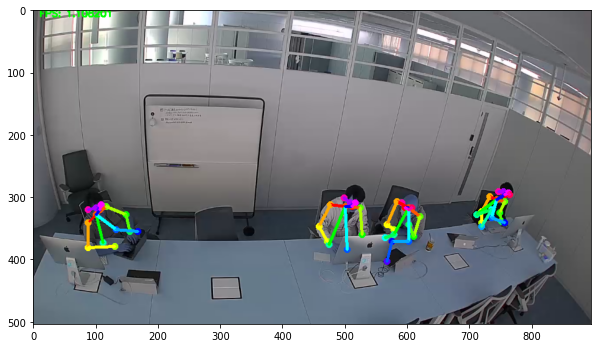

(504, 896, 3)
total time take 0.8780560493469238


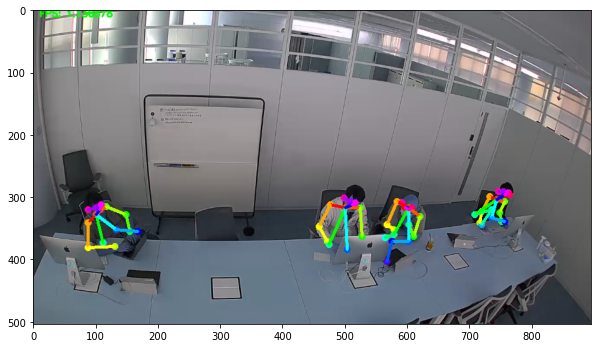

(504, 896, 3)
total time take 0.8926346302032471


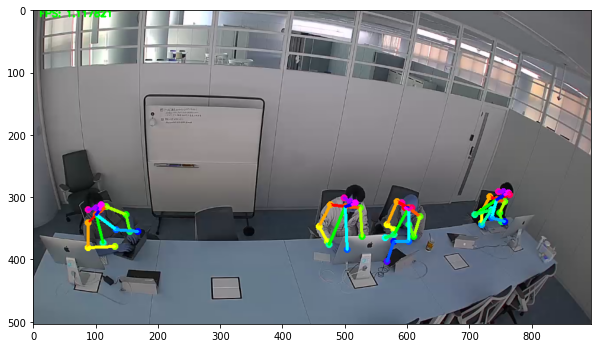

(504, 896, 3)
total time take 0.9101011753082275


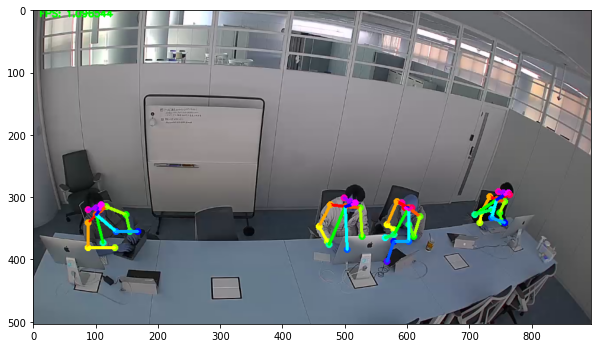

(504, 896, 3)
total time take 0.9272387027740479


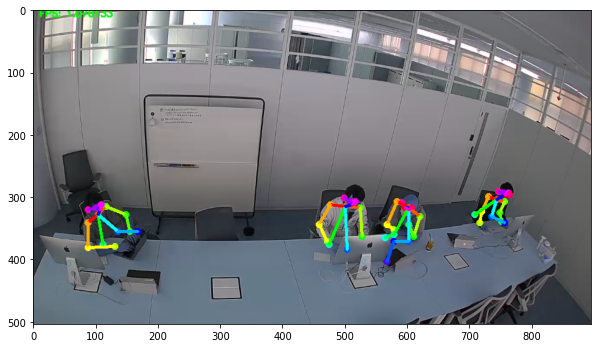

(504, 896, 3)
total time take 0.9093165397644043


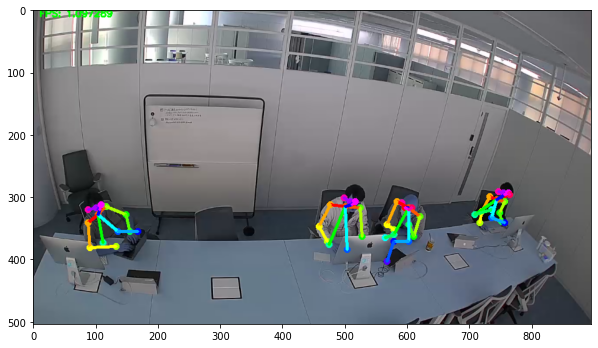

(504, 896, 3)
total time take 0.9254357814788818


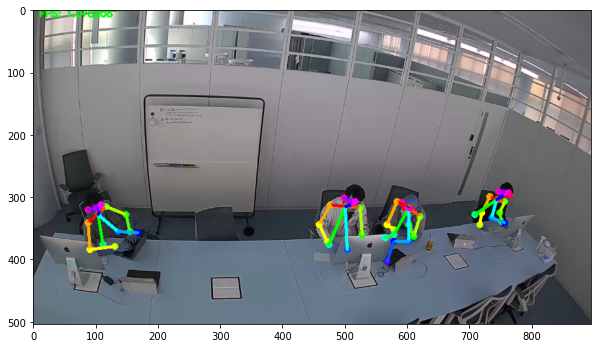

(504, 896, 3)
total time take 0.9063460826873779


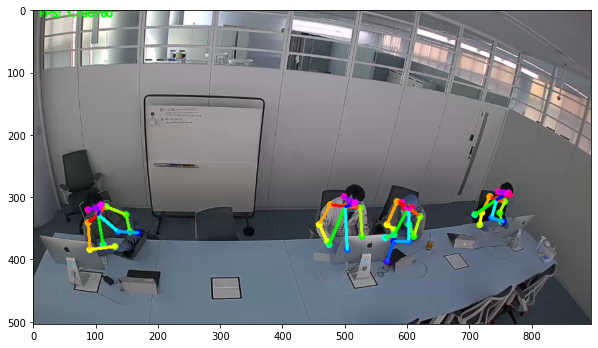

(504, 896, 3)
total time take 0.917625904083252


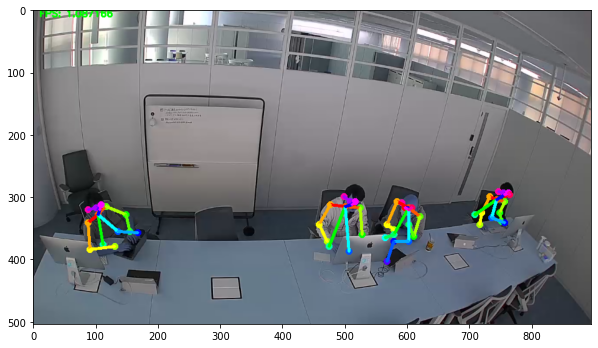

(504, 896, 3)
total time take 0.9322454929351807


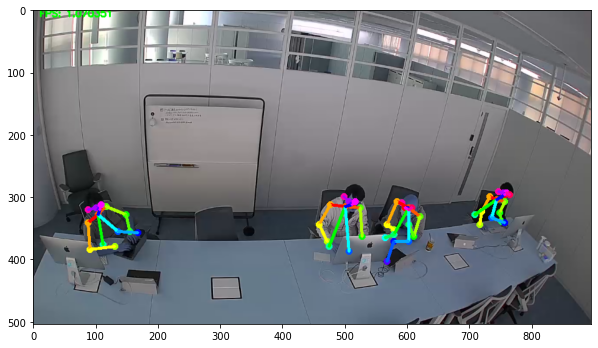

(504, 896, 3)
total time take 0.8842294216156006


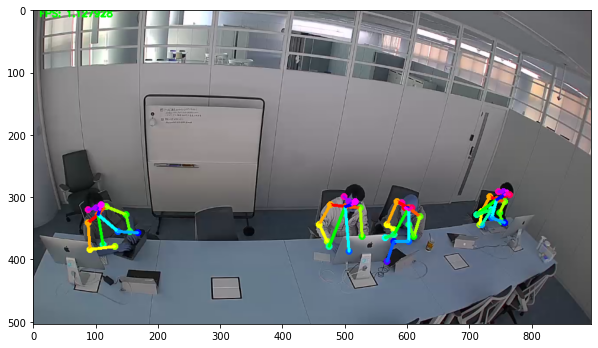

(504, 896, 3)
total time take 0.9049415588378906


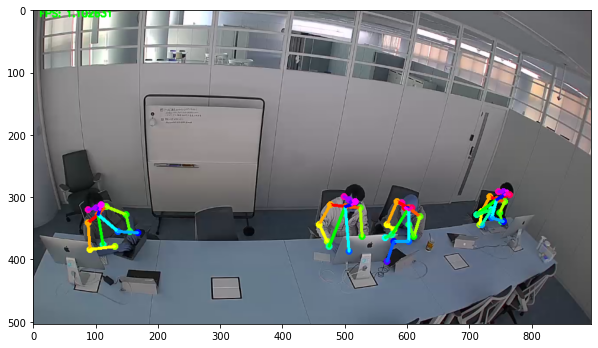

(504, 896, 3)
total time take 0.915985107421875


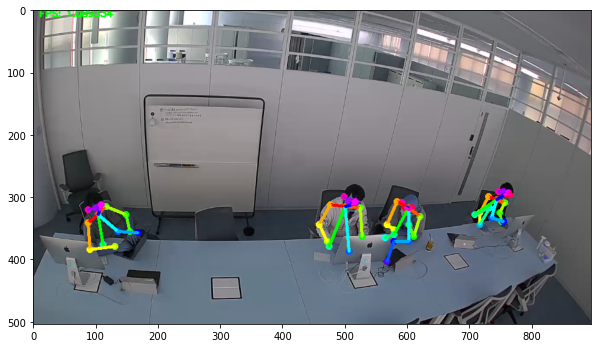

(504, 896, 3)
total time take 0.9172971248626709


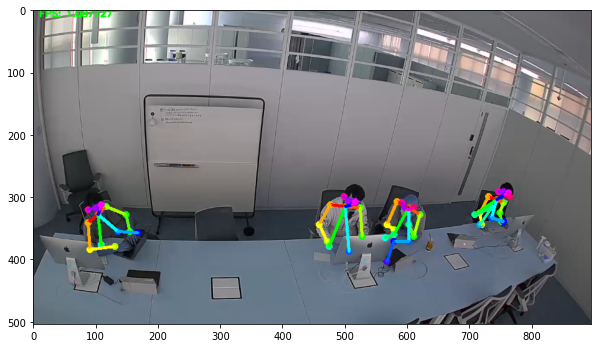

(504, 896, 3)
total time take 0.9107410907745361


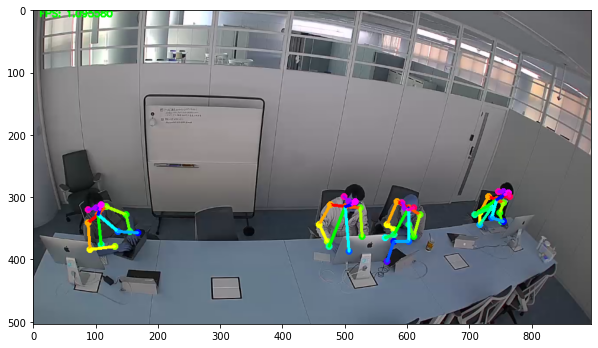

(504, 896, 3)
total time take 0.9319753646850586


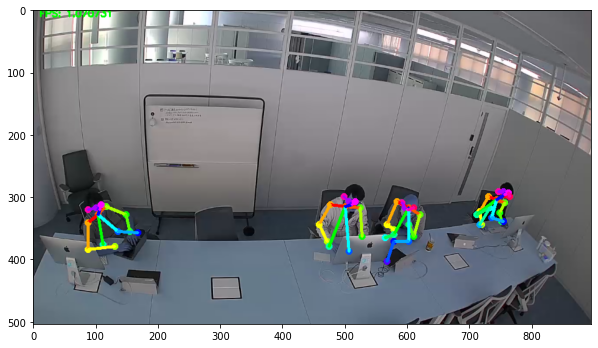

(504, 896, 3)
total time take 0.9144027233123779


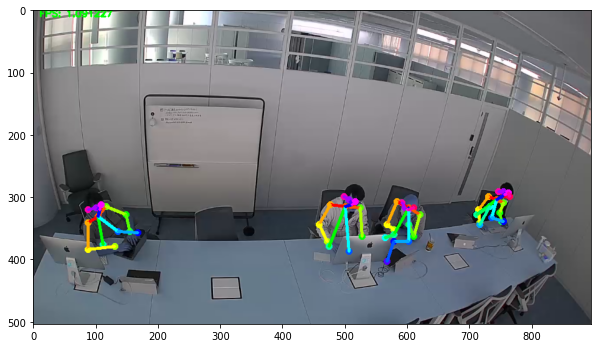

(504, 896, 3)
total time take 0.9243621826171875


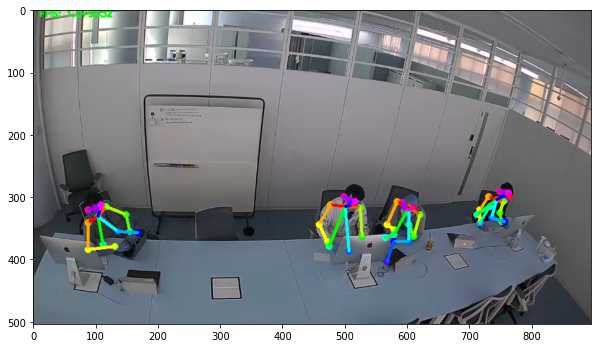

(504, 896, 3)
total time take 0.8989484310150146


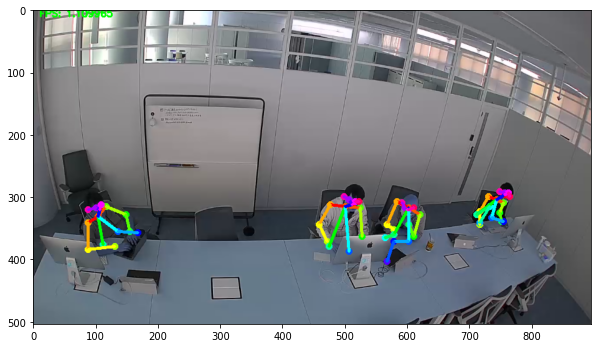

(504, 896, 3)
total time take 0.9227654933929443


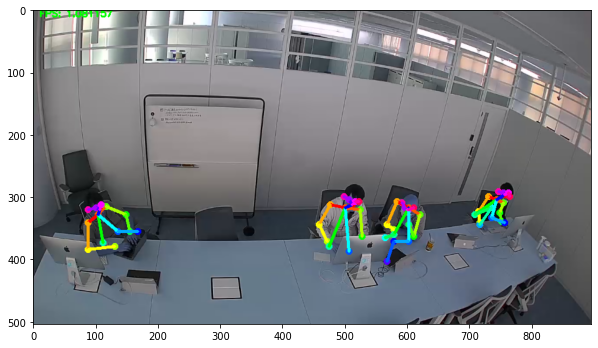

(504, 896, 3)
total time take 0.8931646347045898


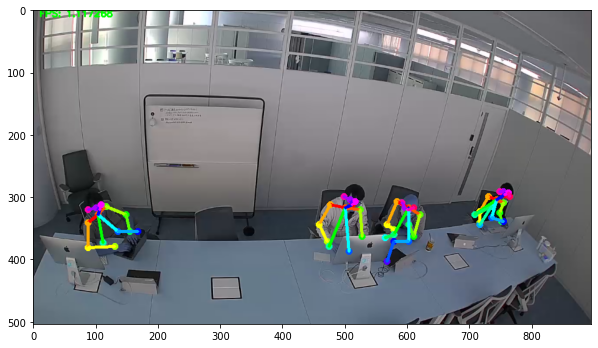

(504, 896, 3)
total time take 0.9218642711639404


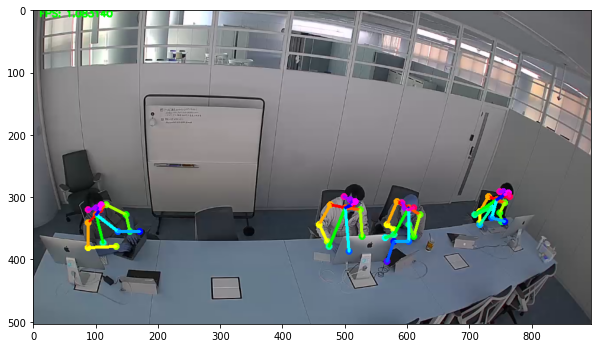

(504, 896, 3)
total time take 0.9318573474884033


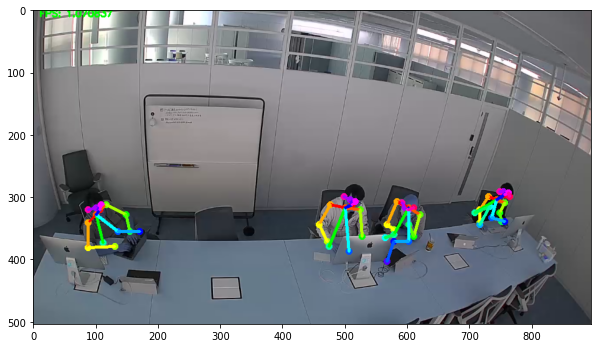

(504, 896, 3)
total time take 0.9243690967559814


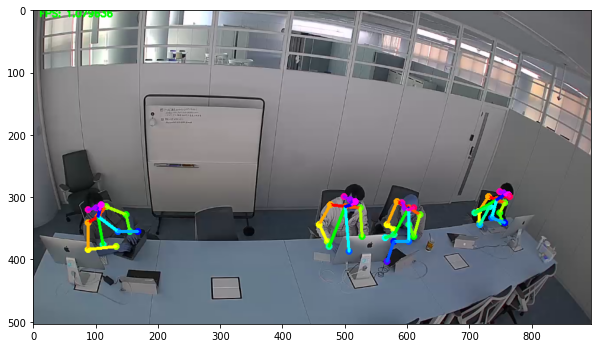

(504, 896, 3)
total time take 0.9157569408416748


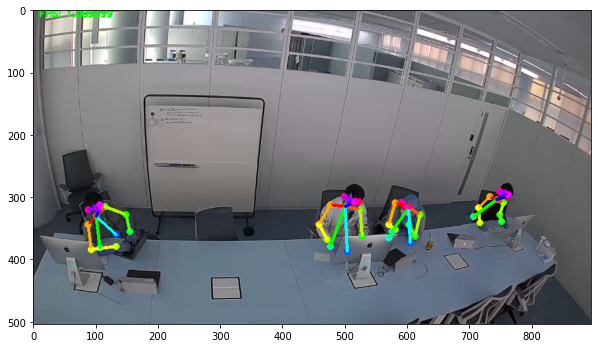

(504, 896, 3)
total time take 0.9331562519073486


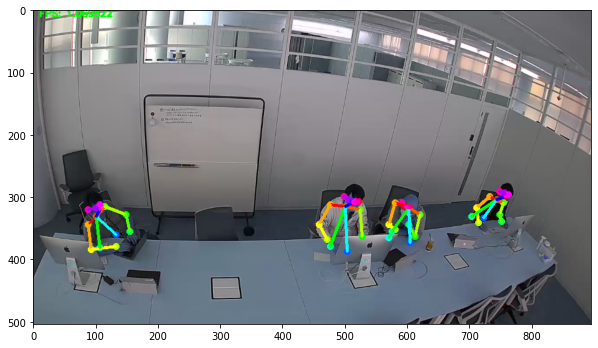

(504, 896, 3)
total time take 0.9228529930114746


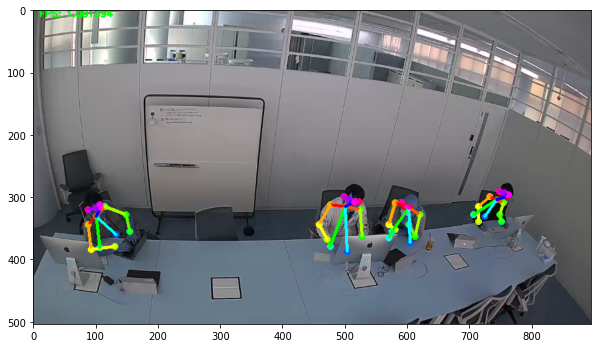

(504, 896, 3)
total time take 0.9156756401062012


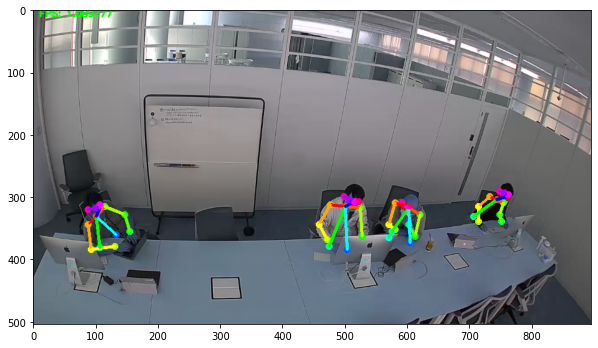

(504, 896, 3)
total time take 0.9027743339538574


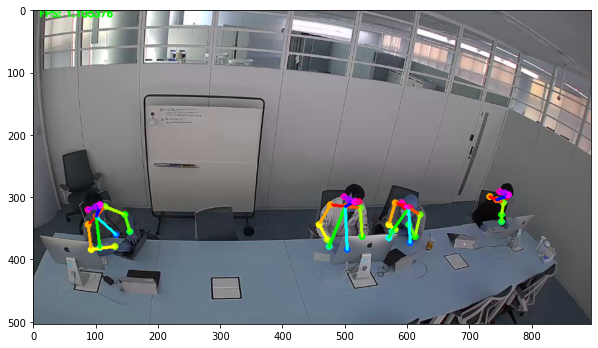

(504, 896, 3)
total time take 0.918419599533081


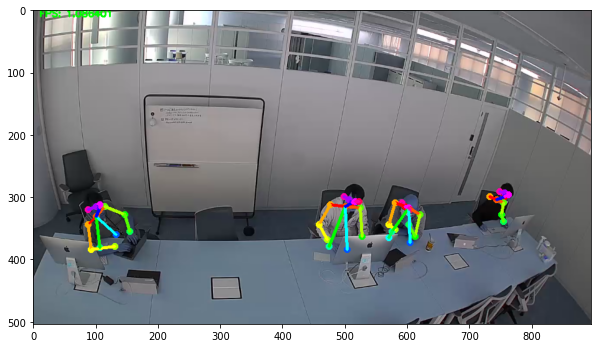

(504, 896, 3)
total time take 0.9138500690460205


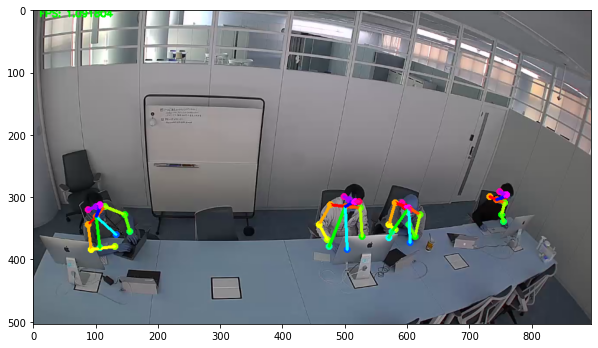

(504, 896, 3)
total time take 0.9366216659545898


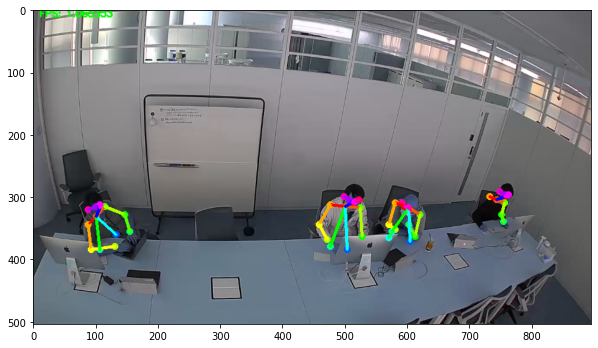

(504, 896, 3)
total time take 0.9429130554199219


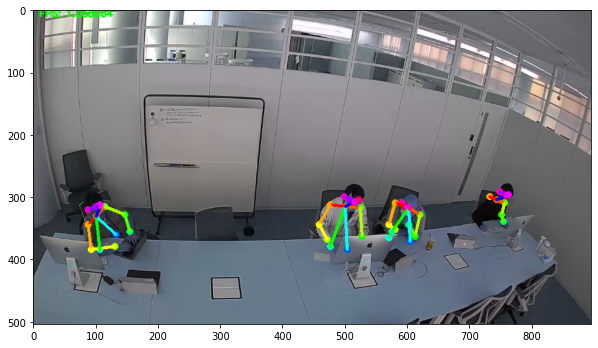

(504, 896, 3)
total time take 0.9220657348632812


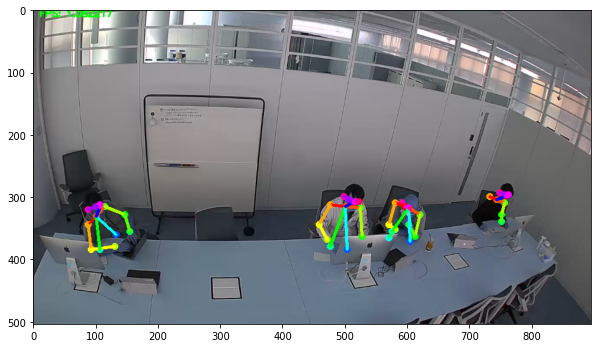

(504, 896, 3)
total time take 0.9103224277496338


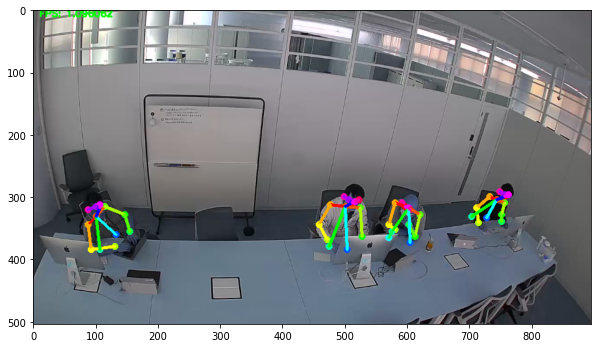

(504, 896, 3)
total time take 0.9134595394134521


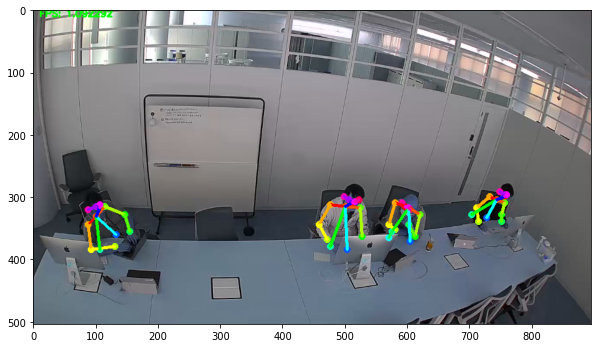

(504, 896, 3)
total time take 0.9202358722686768


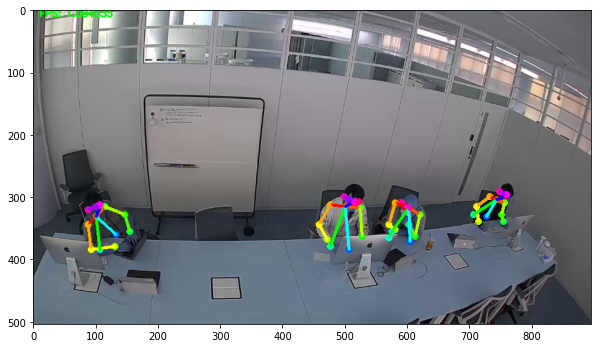

(504, 896, 3)
total time take 0.8766369819641113


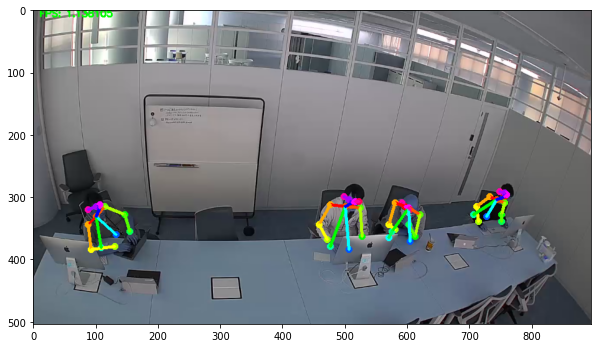

(504, 896, 3)
total time take 0.9310312271118164


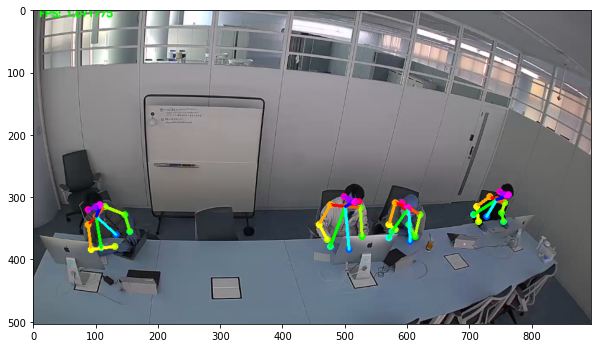

(504, 896, 3)
total time take 0.900672197341919


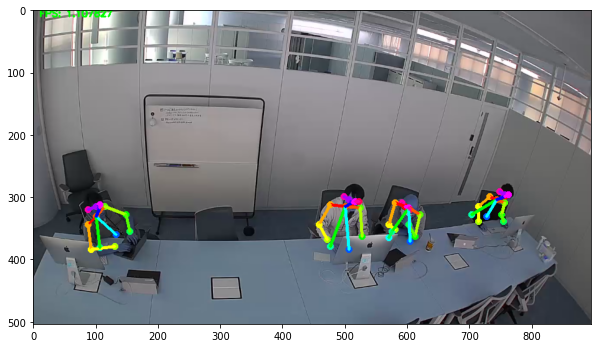

(504, 896, 3)
total time take 0.9405131340026855


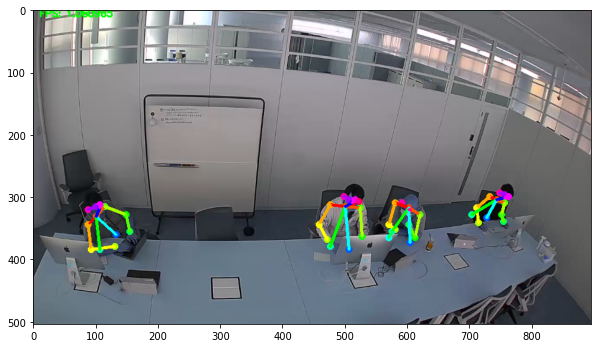

(504, 896, 3)
total time take 0.9278724193572998


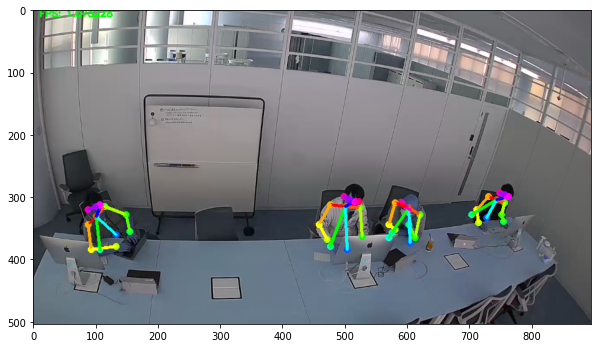

(504, 896, 3)
total time take 0.9124515056610107


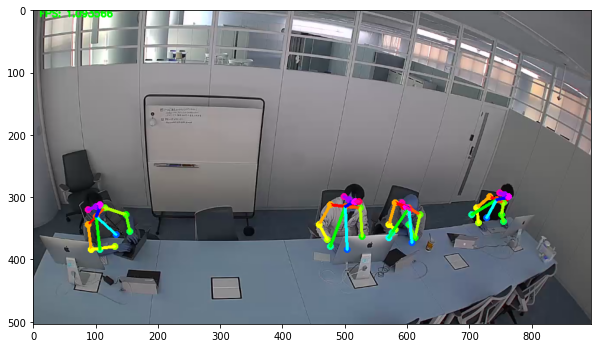

(504, 896, 3)
total time take 0.898853063583374


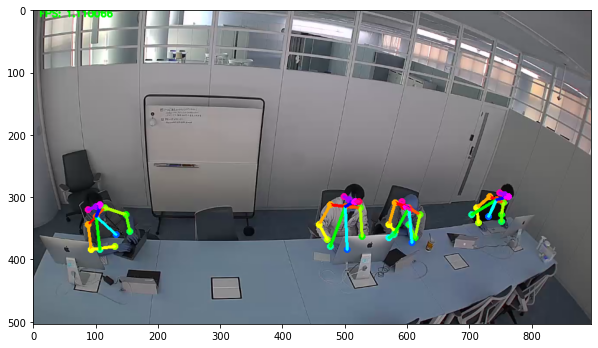

(504, 896, 3)
total time take 0.9147582054138184


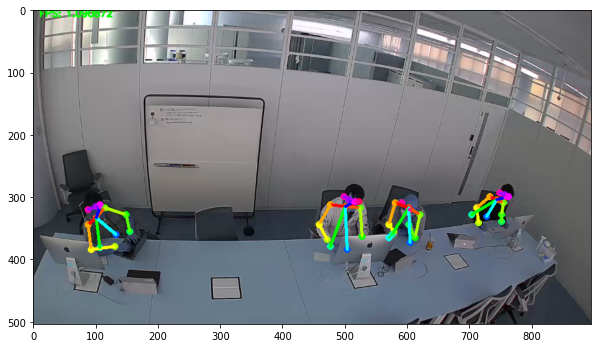

(504, 896, 3)
total time take 0.9190502166748047


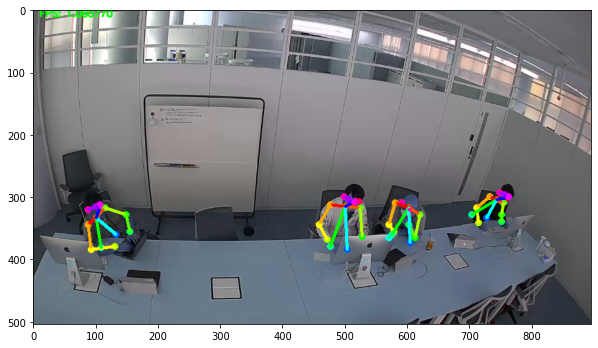

(504, 896, 3)
total time take 0.9096763134002686


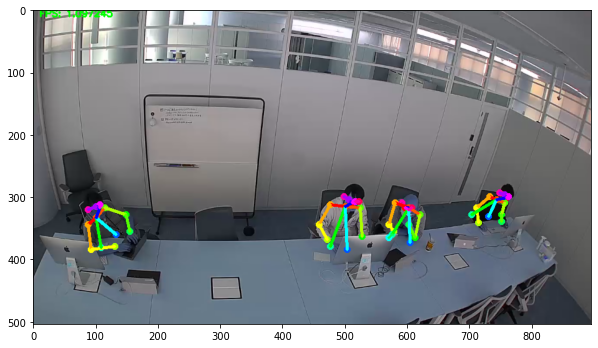

(504, 896, 3)
total time take 0.9281775951385498


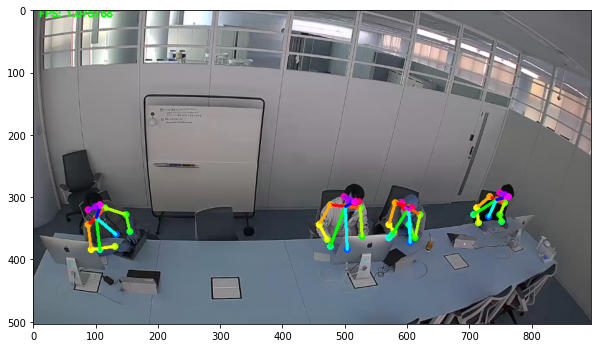

(504, 896, 3)
total time take 0.9077000617980957


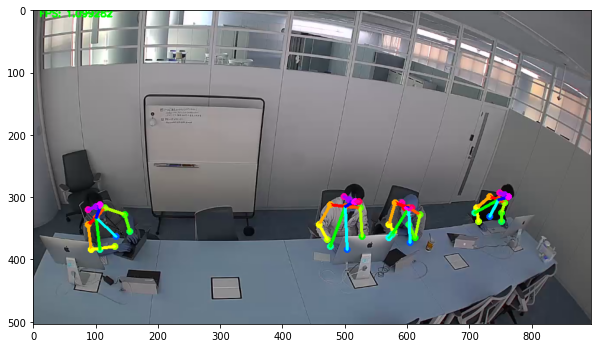

(504, 896, 3)
total time take 0.9220376014709473


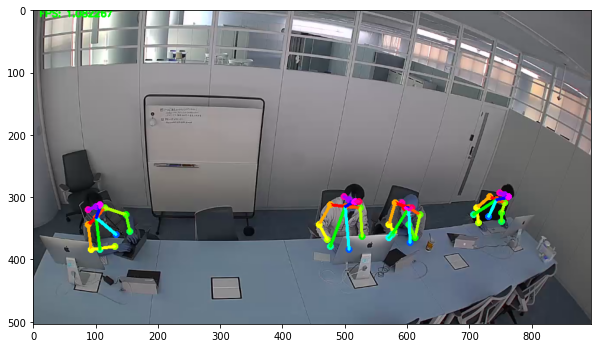

(504, 896, 3)
total time take 0.9092566967010498


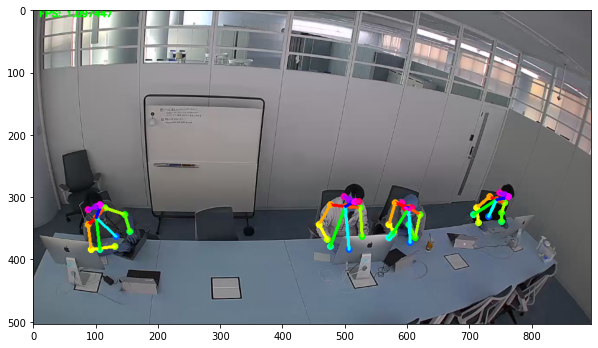

(504, 896, 3)
total time take 0.9198122024536133


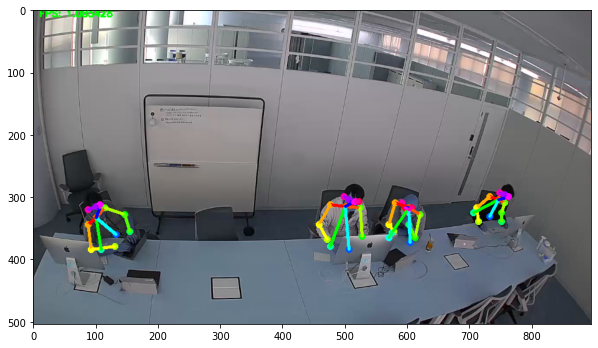

(504, 896, 3)
total time take 0.9143366813659668


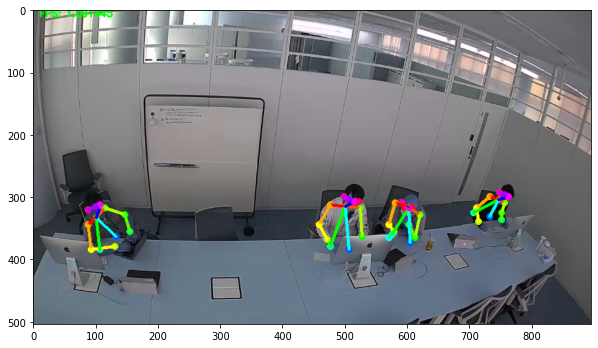

(504, 896, 3)
total time take 0.9089617729187012


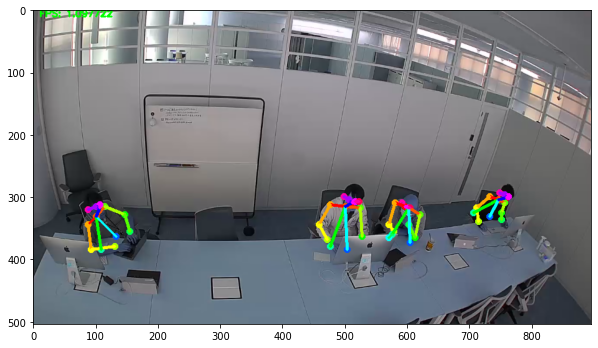

(504, 896, 3)
total time take 0.8965775966644287


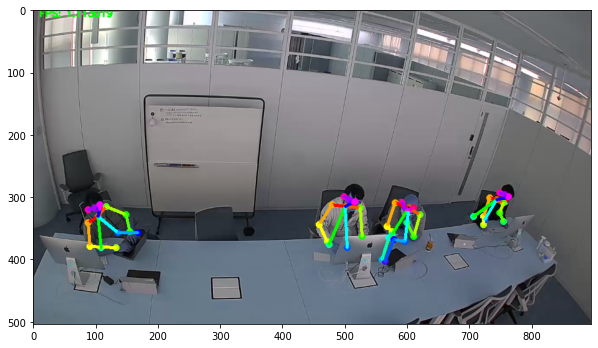

(504, 896, 3)
total time take 0.8841402530670166


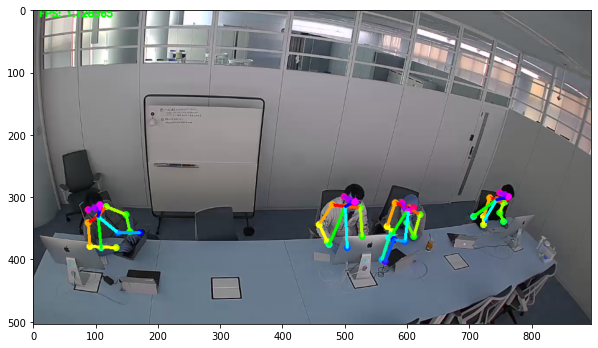

(504, 896, 3)
total time take 0.9204258918762207


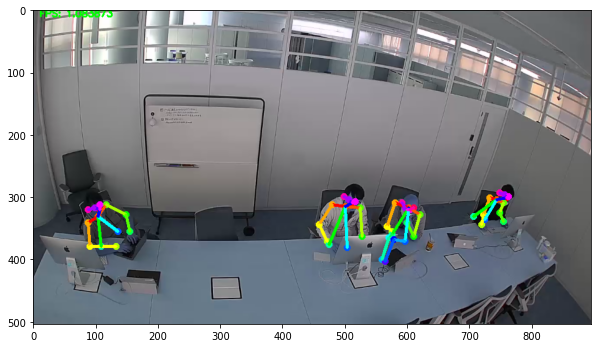

(504, 896, 3)
total time take 0.9237544536590576


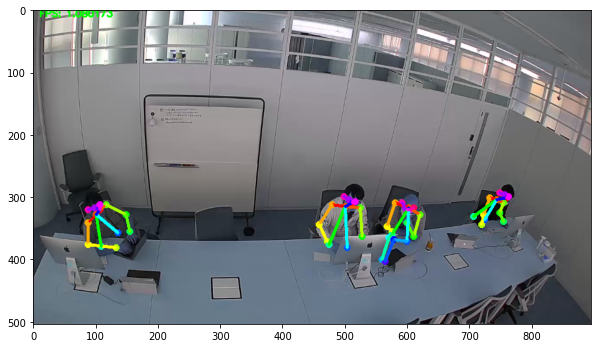

(504, 896, 3)
total time take 0.9244403839111328


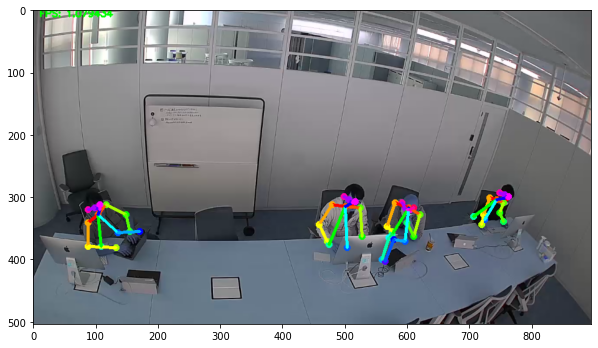

(504, 896, 3)
total time take 0.9161045551300049


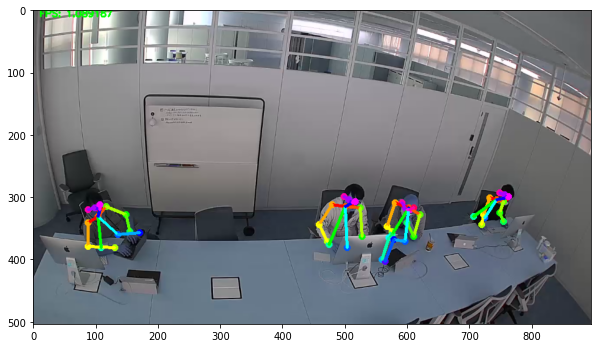

(504, 896, 3)
total time take 0.9099833965301514


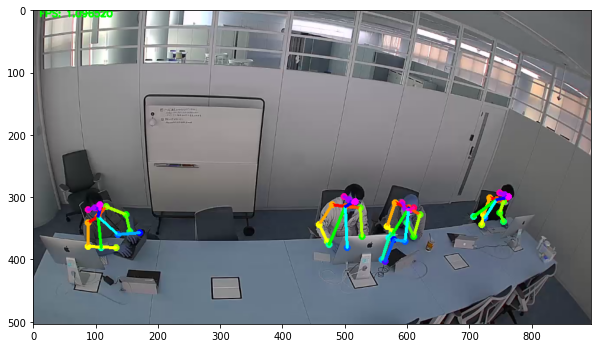

(504, 896, 3)
total time take 0.8996217250823975


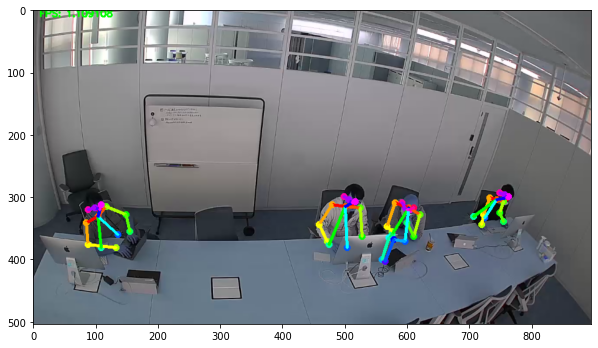

(504, 896, 3)
total time take 0.9028246402740479


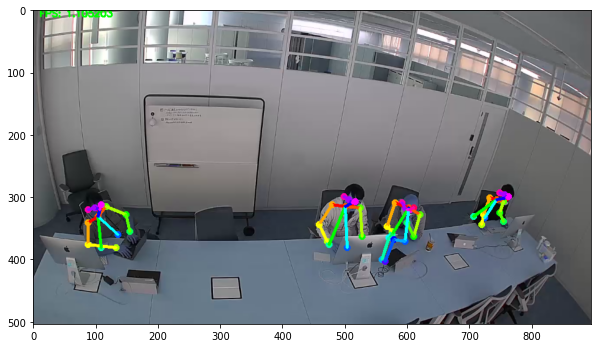

(504, 896, 3)
total time take 0.9317474365234375


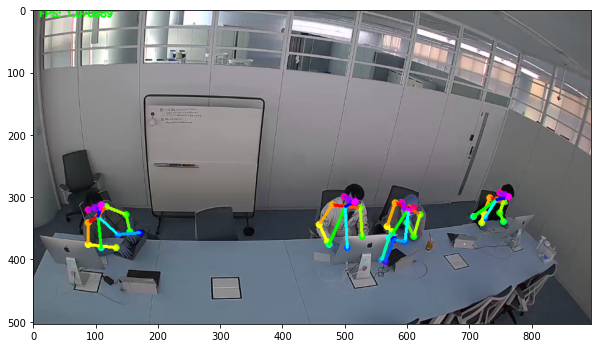

(504, 896, 3)
total time take 0.9102435111999512


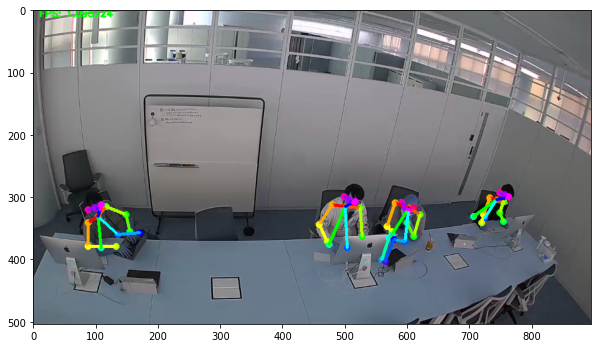

(504, 896, 3)
total time take 0.8848819732666016


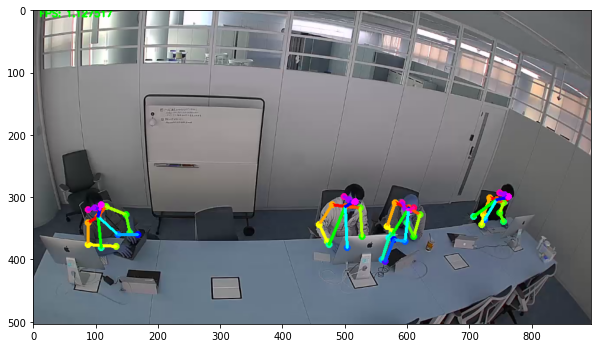

(504, 896, 3)
total time take 0.9141459465026855


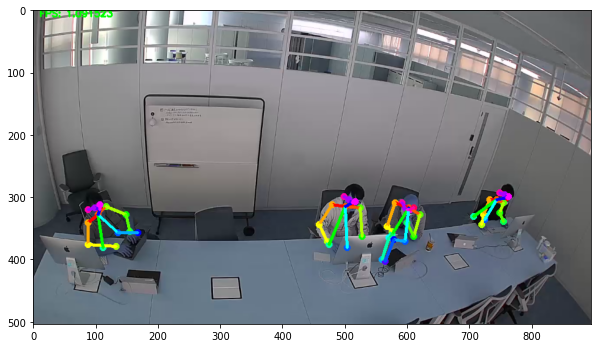

(504, 896, 3)
total time take 0.9213545322418213


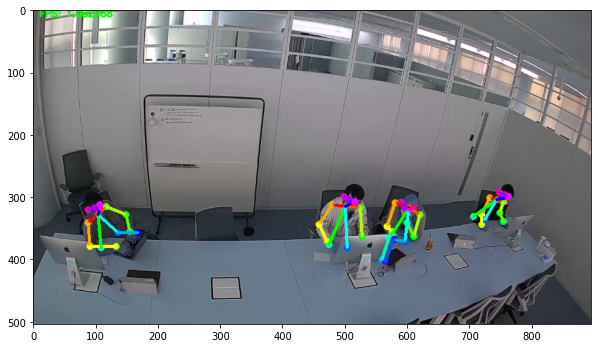

(504, 896, 3)
total time take 0.9117157459259033


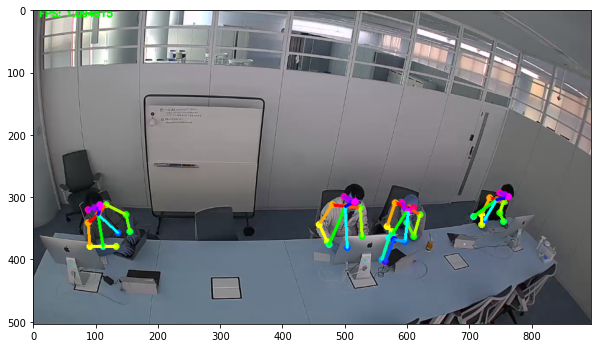

(504, 896, 3)
total time take 0.9200572967529297


In [ ]:
video_path = '../Yet-Another-Openpose-Implementation/saurabh_test.mp4'
fps_time = 0
cap = cv2.VideoCapture(video_path)

while cap.isOpened():
    success, image = cap.read()
    if success:
        start_time = time.time()
        image = cv2.resize(image, (0, 0), fx = 0.7, fy = 0.7)
        print(image.shape)
        humans = e.inference(
        image, resize_to_default=False, upsample_size=3.0
                )
        image = TfPoseEstimator.draw_humans(image, humans, imgcopy=False)
        
        print("total time take {}".format(time.time()-start_time))
        cv2.putText(
            image,
            "FPS: %f" % (1.0 / (time.time() - fps_time)),
            (10, 10),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.5,
            (0, 255, 0),
            2,
        )
        plt.figure(figsize=(10,10))
        plt.imshow(image)
        plt.show()
        fps_time = time.time()
cap.release()
cv2.destroyAllWindows()

## Without resizing (to default) 

total time take 2.446150779724121


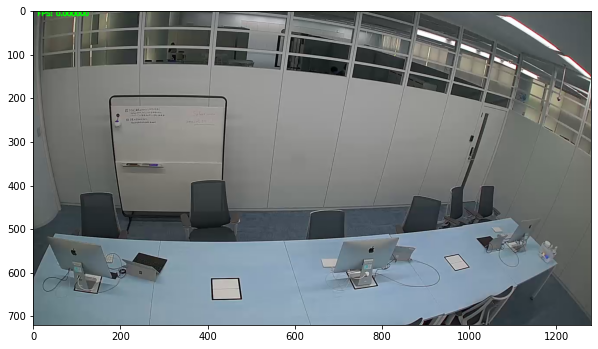

total time take 2.596407175064087


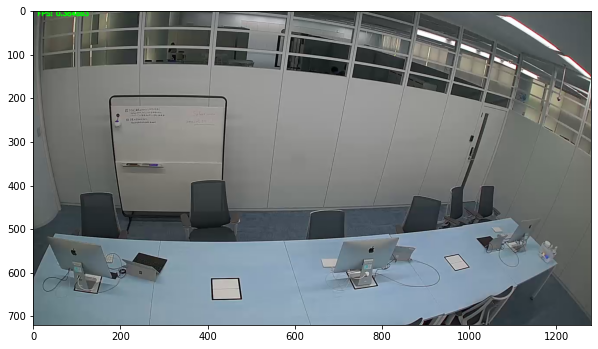

total time take 2.4620800018310547


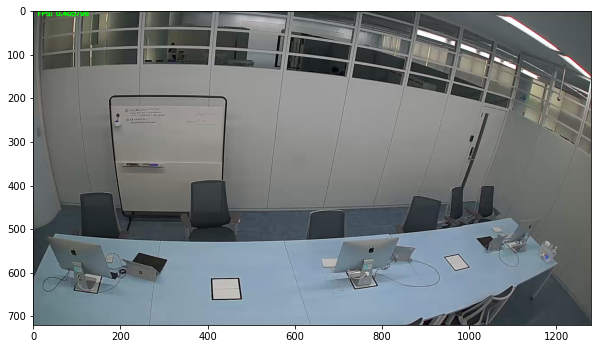

total time take 2.5962042808532715


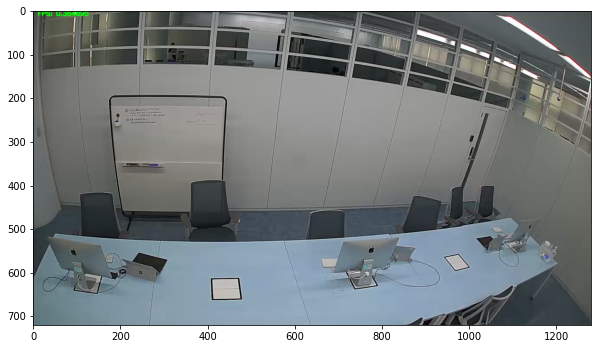

total time take 2.4089481830596924


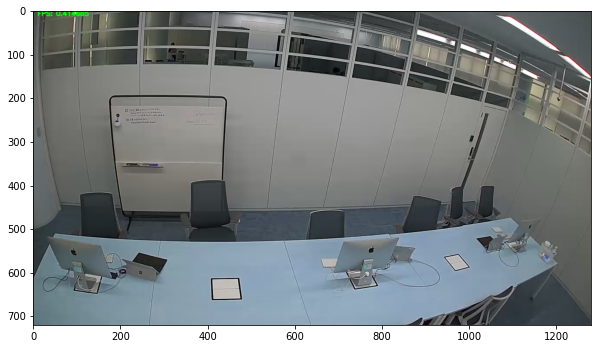

total time take 2.593085289001465


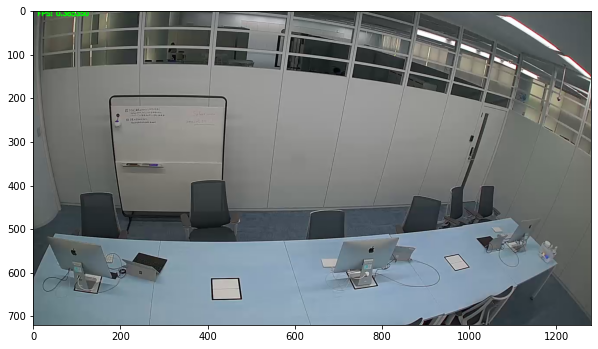

total time take 2.5236244201660156


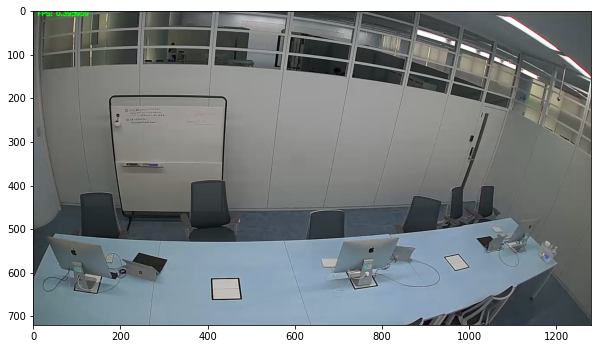

total time take 2.44698429107666


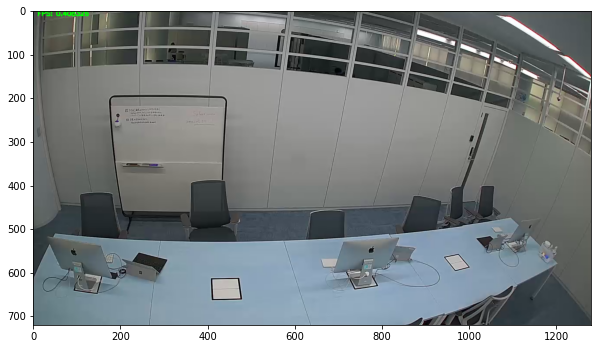

total time take 2.5343198776245117


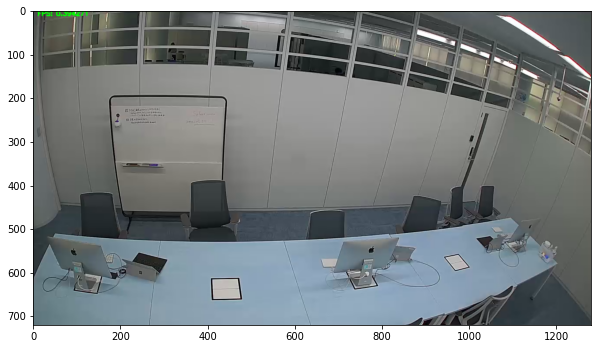

total time take 2.614457845687866


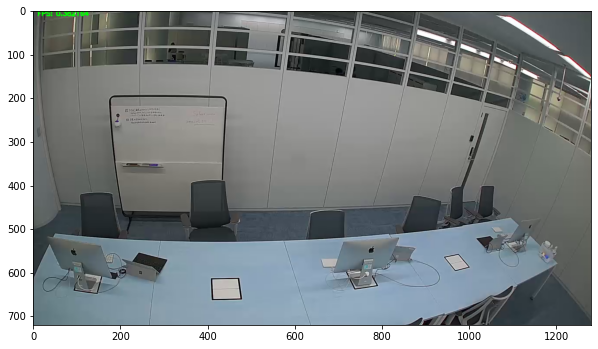

total time take 2.5490119457244873


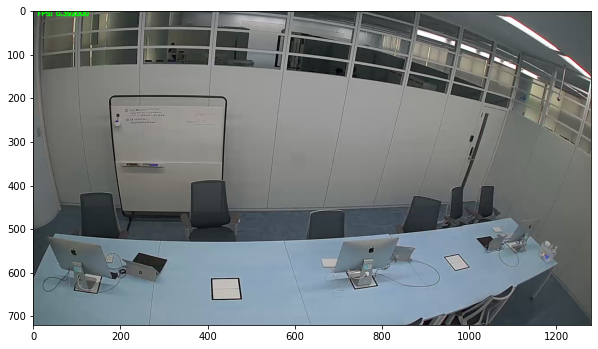

total time take 2.443427801132202


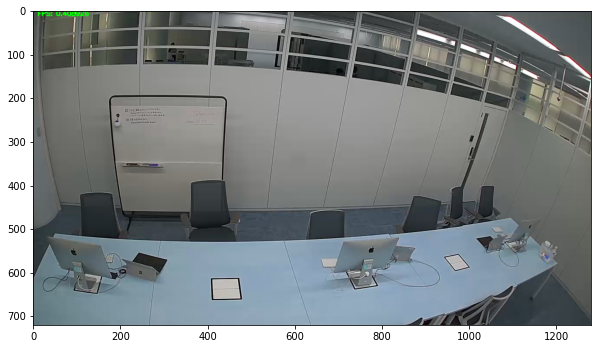

total time take 2.43987774848938


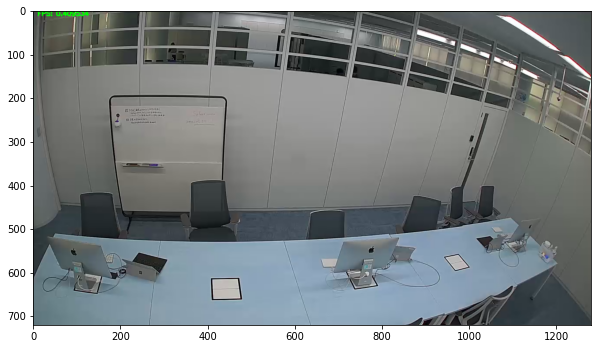

total time take 2.640810251235962


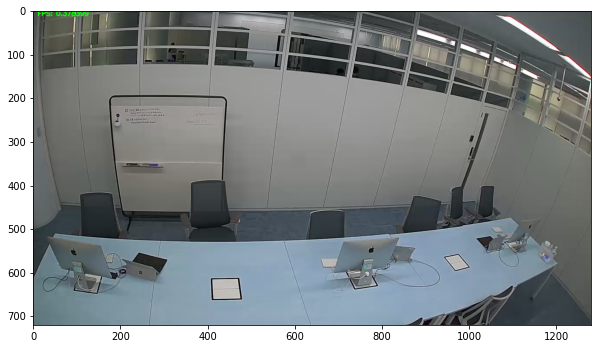

total time take 2.5480921268463135


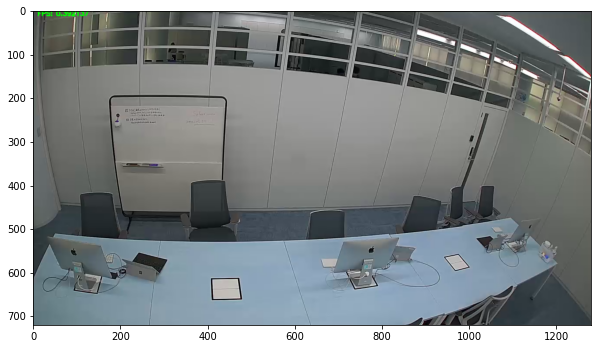

total time take 2.4911611080169678


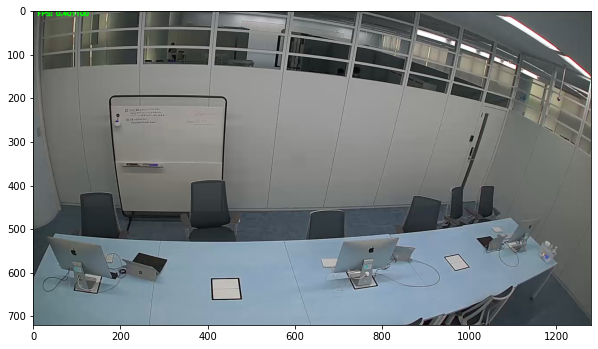

total time take 2.466351270675659


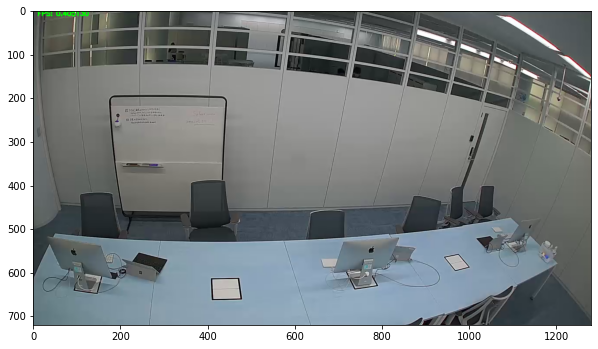

KeyboardInterrupt: 

In [13]:
video_path = '../../human_detection/test_data/video_clips/video_0_5.mp4'
fps_time = 0
cap = cv2.VideoCapture(video_path)

while cap.isOpened():
    success, image = cap.read()
    if success:
        start_time = time.time()
        humans = e.inference(
        image, resize_to_default=False, upsample_size=4.0
                )
        image = TfPoseEstimator.draw_humans(image, humans, imgcopy=False)
        
        print("total time take {}".format(time.time()-start_time))
        cv2.putText(
            image,
            "FPS: %f" % (1.0 / (time.time() - fps_time)),
            (10, 10),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.5,
            (0, 255, 0),
            2,
        )
        plt.figure(figsize=(10,10))
        plt.imshow(image)
        plt.show()
        fps_time = time.time()
cap.release()
cv2.destroyAllWindows()

## other pretrained models wit the above code base


In [17]:
graph_path = '../Yet-Another-Openpose-Implementation/trained_models/model11_test-15Sun1219-2101/'

In [18]:
model = tf.keras.models.load_model(graph_path)

Instructions for updating:
If using Keras pass *_constraint arguments to layers.


2021-07-29 12:25:25,486 WARNING From /home/local/ALGOANALYTICS/arun/arun_work/CAFIS_Nikhil/human_detection/human-detection/lib/python3.6/site-packages/tensorflow/python/ops/resource_variable_ops.py:1666: calling BaseResourceVariable.__init__ (from tensorflow.python.ops.resource_variable_ops) with constraint is deprecated and will be removed in a future version.
Instructions for updating:
If using Keras pass *_constraint arguments to layers.


2021-07-29 12:25:33,552 WARNING No training configuration found in save file, so the model was *not* compiled. Compile it manually.


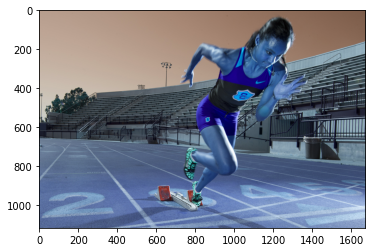

In [21]:
image_path  = 'test_pose.jfif'
image = cv2.imread(image_path)
plt.imshow(image)
plt.show()

In [22]:
input_img = tf.image.resize(image, (368, 368))
input_img = tf.image.convert_image_dtype(input_img, dtype=tf.float32)
input_img /= 255



input_img = input_img[tf.newaxis, ...]

In [32]:
pafs, kpts = model.predict(input_img, steps=1)

In [40]:
len(kpts[0][0][0])

18

In [41]:
pafs = pafs[0]
kpts = kpts[0]